# Introduction to machine learning & Data Analysis

Basic introduction on how to perform typical machine learning tasks with scikit-learn package in Python.

Prepared by Mykhailo Vladymyrov, Data Science Lab, University Of Bern, 2023

Partially based on earlier material by M. Vladymyrov & A. Marcolongo.

This work is licensed under <a href="https://creativecommons.org/share-your-work/public-domain/cc0/">CC0</a>.


# What is Machine Learning?

## Learning from data

Unlike classical algorithms, created by a human to analyze some data:

<img src="https://github.com/neworldemancer/DSF5/raw/master/figures/alg_1.png" width="60%"/>

in machine learning the data itself is used for to define the algorithm:

<img src="https://github.com/neworldemancer/DSF5/raw/master/figures/alg_2.png" width="60%"/>

Machine learning - is learnign from data.
If 
* performance on a task **T**
* improves according to measure **P**
* with experience **E**

we say that model learns form data.


<img src="https://github.com/neworldemancer/DSF5/raw/master/figures/alg_3.png" width="60%"/>


The boundary is a bit fuzzy.

In fact when we create algorithms, the problem in hand (namely the data  related to the problem), drives us to choose one or another algorithm. And we then tune it, to perform well on a task in hand. 

Machine Learning (ML) formalized this procedure, allowing us to automate (part) of this process.

In this course you will get acquainted with the basics of Machine Learning — where the approach to handling the data (the algorithm) is defined, or as we say "learned" from data in hand.

## Classification vs Regression.

The two main tasks handled by (supervised) ML is regression and classification.
In regression we aim at modeling the relationship between the system's response (dependent variable) and one or more explanatory variables (independent variables).

Examples of regression would be predicting the temperature for each day of the year, or expenses of the household as a function of the number of children and adults.

In classification the aim is to identify what class does a data-point belong to. For example, the species or the iris plant based on the size of its petals, or whether an email is spam or not based on its content.

## Performance measures


1. Regression:
* Mean Square Error: $\textrm{MSE}=\frac{1}{n}\sum_i(y_i - \hat y(\bar x_i))^2$
* Mean Absolute Error: $\textrm{MAE}=\frac{1}{n}\sum_i|y_i - \hat y(\bar x_i)|$
* Median Absolute Deviation: $\textrm{MAD}=\textrm{median}(|y_i - \hat y(\bar x_i)|)$
* Fraction of the explained variance: $R^2=1-\frac{\sum_i(y_i - \hat y(\bar x_i))^2}{\sum_i(y_i - \bar y_i)^2}$, where $\bar y=\frac{1}{n}\sum_i y_i$

2. Classification:
* Confusion matrix 


<img src="https://github.com/neworldemancer/DSF5/raw/master/figures/confusion_mtr.png" width="46%"/>

* Accuracy $=\frac{\textrm{TP} + \textrm{TN}}{\textrm{TP} + \textrm{FP} + \textrm{FN} + \textrm{TN}}$
* Precision $=\frac{\textrm{TP}}{\textrm{TP} + \textrm{FP}}$ 
* Recall $=\frac{\textrm{TP}}{\textrm{TP} + \textrm{FN}}$
* F1 $=\frac{2}{\frac{1}{\textrm{Precision}} + \frac{1}{\textrm{Recall}} } = 2\frac{\textrm{Precision} \cdot \textrm{Recall}}{\textrm{Precision} + \textrm{Recall}} = \frac{2 \textrm{TP}}{2 \textrm{TP} + \textrm{FP} + \textrm{FN}} = \frac{\textrm{TP}}{\textrm{TP} + \frac{\textrm{FP} + \textrm{FN}}{2}}$
* F2 $=\frac{5}{\frac{1}{\textrm{Precision}} + \frac{4}{\textrm{Recall}} } = 5\frac{\textrm{Precision} \cdot \textrm{Recall}}{4 \cdot \textrm{Precision} + \textrm{Recall}} = \frac{5 \textrm{TP}}{5 \textrm{TP} + \textrm{FP} + 4 \cdot \textrm{FN}} = \frac{\textrm{TP}}{\textrm{TP} + \frac{\textrm{FP} + 4 \cdot\textrm{FN}}{5}}$
* Threat score (TS), or Intersection over Union: $\mathrm{IoU}=\frac{\mathrm{TP}}{\mathrm{TP}+\mathrm{FN}+\mathrm{FP}}$


During model optimization the used measure in most cases must be differentiable. To this end usually some measure of similarities of distributions are employed (e.g. cross-entropy).

## Actual aim: Generalization

<img src="https://github.com/neworldemancer/DSF5/raw/master/figures/Bias_variance_1.png" width="35%"/>

<img src="https://github.com/neworldemancer/DSF5/raw/master/figures/Bias_variance_2.png" width="60%"/>

To measure model performance in an unbiassed way, we need to use different data than the data that the model was trained on. For this we use the 'train-test' split: e.g. 20% of all available dataset is reserved for model performance test, and the remaining 80% is used for actual model training.

# Load libraries

In [6]:
# Scikit-learn (formerly scikits.learn and also known as sklearn) is a free 
# software machine learning library for the Python programming language. 
# It features various classification, regression and clustering algorithms, 
# and is designed to interoperate with the Python numerical and scientific 
# libraries NumPy and SciPy. (from wiki)

from sklearn import linear_model
from sklearn import tree
from sklearn import ensemble

from sklearn.datasets import make_blobs
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.inspection import permutation_importance
from sklearn.manifold import TSNE
from sklearn.cluster import DBSCAN
from sklearn.mixture import GaussianMixture

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# common visualization module
from matplotlib import pyplot as plt
import plotly.express as px
import seaborn as sns
sns.set()

# numeric library
import numpy as np

import os
import pandas as pd
from time import time as timer
import tarfile

import tensorflow as tf
from scipy.stats import entropy


%matplotlib inline
from matplotlib import animation
from IPython.display import HTML
from IPython.display import SVG


In [80]:
pip install umap-learn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 kB 3.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 18.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82816 sha256=14f64ba996f04f64594779c4e8f4040b4b6a3f1585141a8c841e47974586a809
  Stored in directory: /root/.cache/pip/wheels/a0/e8/c6/a37ea663620bd5200ea1ba0907ab3c217042c1d035ef606acc
  Created wheel for pynndescent: filename=pynndescent-0.5.10-py3-none-any.whl size=55622 sha256=4d51e2c1d6a3be8aeaf6c0e30c1448d3d83b7a538b8fb932d7750bf9da08bd8f
  Stored in directory: /root/.cache/pip/wheels/4a/38/5d/f60a40a66a9512b7e5e83517ebc2d1b42d857be97d135f1096
Successfully built umap-learn pynndescent


In [81]:
pip install dtreeviz

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [82]:
import dtreeviz
import umap

In [9]:
if not os.path.exists('data'):
    path = os.path.abspath('.')+'/colab_material.tgz'
    tf.keras.utils.get_file(path, 'https://github.com/neworldemancer/DSF5/raw/master/colab_material.tgz')
    tar = tarfile.open(path, "r:gz")
    tar.extractall()
    tar.close()

In [10]:
from utils.routines import *

# Datasets

In this course we will use several synthetic and real-world datasets to illustrate the behavior of the models and exercise our skills.

## 1. Synthetic linear

In [11]:
def get_linear(n_d=1, n_points=10, w=None, b=None, sigma=5):
  x = np.random.uniform(0, 10, size=(n_points, n_d))
  
  w = w or np.random.uniform(0.1, 10, n_d)
  b = b or np.random.uniform(-10, 10)
  y = np.dot(x, w) + b + np.random.normal(0, sigma, size=n_points)

  print('true slopes: w =', w, ';  b =', b)

  return x, y

true slopes: w = [8.67808002] ;  b = 0.5814754937399886


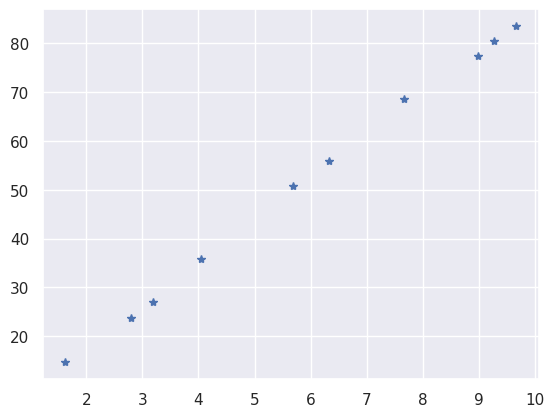

In [12]:
x, y = get_linear(n_d=1, sigma=1)
plt.plot(x[:, 0], y, '*')
plt.show()

true slopes: w = [5.36481203 7.78269864] ;  b = 9.640193233784316


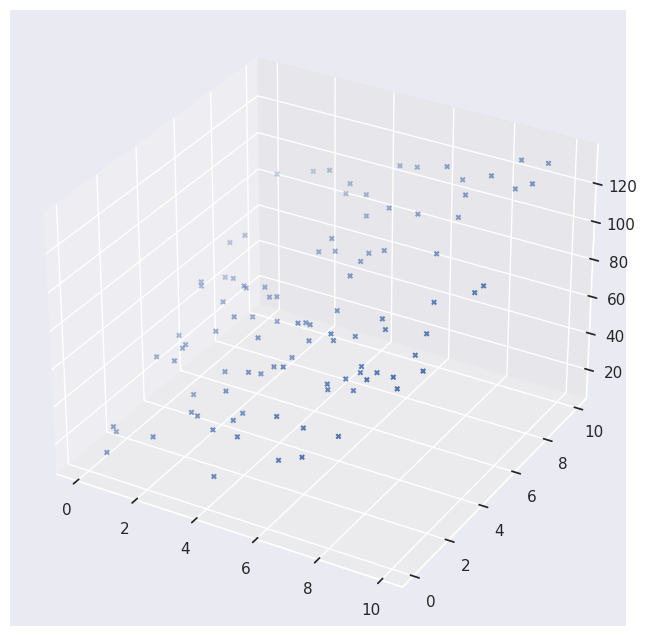

In [13]:
n_d = 2
x, y = get_linear(n_d=n_d, n_points=100)

fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x[:,0], x[:,1], y, marker='x', color='b',s=10)
plt.show()

## 2. House prices

Subset of the Ames Houses dataset: http://jse.amstat.org/v19n3/decock.pdf

In [14]:
def house_prices_dataset(return_df=False, return_df_xy=False, use_dummies=False, price_max=400000, area_max=40000):
  path = 'data/AmesHousing.csv'

  df = pd.read_csv(path, na_values=('NaN', ''), keep_default_na=False,  )
  
  rename_dict = {k:k.replace(' ', '').replace('/', '') for k in df.keys()}
  df.rename(columns=rename_dict, inplace=True)
  
  useful_fields = ['LotArea',
                  'Utilities', 'OverallQual', 'OverallCond',
                  'YearBuilt', 'YearRemodAdd', 'ExterQual', 'ExterCond',
                  'HeatingQC', 'CentralAir', 'Electrical',
                  '1stFlrSF', '2ndFlrSF','GrLivArea',
                  'FullBath', 'HalfBath',
                  'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual', 'TotRmsAbvGrd',
                  'Functional','PoolArea',
                  'YrSold', 'MoSold'
                  ]
  target_field = 'SalePrice'

  df.dropna(axis=0, subset=useful_fields+[target_field], inplace=True)

  cleanup_nums = {'Street':      {'Grvl': 0, 'Pave': 1},
                  'LotFrontage': {'NA':0},
                  'Alley':       {'NA':0, 'Grvl': 1, 'Pave': 2},
                  'LotShape':    {'IR3':0, 'IR2': 1, 'IR1': 2, 'Reg':3},
                  'Utilities':   {'ELO':0, 'NoSeWa': 1, 'NoSewr': 2, 'AllPub': 3},
                  'LandSlope':   {'Sev':0, 'Mod': 1, 'Gtl': 3},
                  'ExterQual':   {'Po':0, 'Fa': 1, 'TA': 2, 'Gd': 3, 'Ex':4},
                  'ExterCond':   {'Po':0, 'Fa': 1, 'TA': 2, 'Gd': 3, 'Ex':4},
                  'BsmtQual':    {'NA':0, 'Po':1, 'Fa': 2, 'TA': 3, 'Gd': 4, 'Ex':5},
                  'BsmtCond':    {'NA':0, 'Po':1, 'Fa': 2, 'TA': 3, 'Gd': 4, 'Ex':5},
                  'BsmtExposure':{'NA':0, 'No':1, 'Mn': 2, 'Av': 3, 'Gd': 4},
                  'BsmtFinType1':{'NA':0, 'Unf':1, 'LwQ': 2, 'Rec': 3, 'BLQ': 4, 'ALQ':5, 'GLQ':6},
                  'BsmtFinType2':{'NA':0, 'Unf':1, 'LwQ': 2, 'Rec': 3, 'BLQ': 4, 'ALQ':5, 'GLQ':6},
                  'HeatingQC':   {'Po':0, 'Fa': 1, 'TA': 2, 'Gd': 3, 'Ex':4},
                  'CentralAir':  {'N':0, 'Y': 1},
                  'Electrical':  {'':0, 'NA':0, 'Mix':1, 'FuseP':2, 'FuseF': 3, 'FuseA': 4, 'SBrkr': 5},
                  'KitchenQual': {'Po':0, 'Fa': 1, 'TA': 2, 'Gd': 3, 'Ex':4},
                  'Functional':  {'Sal':0, 'Sev':1, 'Maj2': 2, 'Maj1': 3, 'Mod': 4, 'Min2':5, 'Min1':6, 'Typ':7},
                  'FireplaceQu': {'NA':0, 'Po':1, 'Fa': 2, 'TA': 3, 'Gd': 4, 'Ex':5},
                  'PoolQC':      {'NA':0, 'Fa': 1, 'TA': 2, 'Gd': 3, 'Ex':4},
                  'Fence':       {'NA':0, 'MnWw': 1, 'GdWo': 2, 'MnPrv': 3, 'GdPrv':4},
                  }

  df_X = df[useful_fields].copy()                              
  if use_dummies:
    cols = [k for k in cleanup_nums.keys() if k in useful_fields]
    df_X = pd.get_dummies(df_X, columns=cols)  # the categorical variables will be changed to one-hot encoding
  else:
    df_X.replace(cleanup_nums, inplace=True)  # convert continous categorial variables to numerical. Applicable only to 

  df_Y = df[target_field].copy()

  x = df_X.to_numpy().astype(np.float32)
  y = df_Y.to_numpy().astype(np.float32)

  if price_max>0:
    idxs = y<price_max
    x = x[idxs]
    y = y[idxs]

  if area_max>0:
    idxs = x[:,0]<area_max
    x = x[idxs]
    y = y[idxs]

  return (x, y, df) if return_df else ((x, y, (df_X, df_Y)) if return_df_xy else (x,y))

In [15]:
# x, y, (df_X, df_Y) = house_prices_dataset(return_df_xy=True, use_dummies=True)
# print(x.shape, y.shape)
# df_X.head()

In [16]:
# df_X.describe()

In [17]:
x, y, (df_X, df_Y) = house_prices_dataset(return_df_xy=True, use_dummies=False)
print(x.shape, y.shape)
df_X.head()

(2847, 24) (2847,)


,LotArea,Utilities,OverallQual,OverallCond,YearBuilt,YearRemodAdd,ExterQual,ExterCond,HeatingQC,CentralAir,...,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,PoolArea,YrSold,MoSold
0,31770,3,6,5,1960,1960,2,2,1,1,...,1,0,3,1,2,7,7,0,2010,5
1,11622,3,5,6,1961,1961,2,2,2,1,...,1,0,2,1,2,5,7,0,2010,6
2,14267,3,6,6,1958,1958,2,2,2,1,...,1,1,3,1,3,6,7,0,2010,6
3,11160,3,7,5,1968,1968,3,2,4,1,...,2,1,3,1,4,8,7,0,2010,4
4,13830,3,5,5,1997,1998,2,2,3,1,...,2,1,3,1,2,6,7,0,2010,3


In [18]:
df_X.describe()

,LotArea,Utilities,OverallQual,OverallCond,YearBuilt,YearRemodAdd,ExterQual,ExterCond,HeatingQC,CentralAir,...,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,PoolArea,YrSold,MoSold
count,2929.00000,2929.000000,2929.000000,2929.000000,2929.000000,2929.000000,2929.000000,2929.000000,2929.000000,2929.000000,...,2929.000000,2929.000000,2929.000000,2929.000000,2929.000000,2929.000000,2929.000000,2929.000000,2929.000000,2929.000000
mean,10148.06282,2.998634,6.095254,5.563332,1971.344486,1984.258791,2.398771,2.085353,3.149539,0.933083,...,1.566405,0.379310,2.854216,1.044384,2.511096,6.442813,6.843974,2.244111,2007.790372,6.216456
std,7881.35958,0.045247,1.411122,1.111678,30.243747,20.859616,0.580370,0.371758,0.958230,0.249921,...,0.552977,0.502584,0.827868,0.214111,0.663214,1.573199,0.663164,35.603235,1.316832,2.714863
min,1300.00000,1.000000,1.000000,1.000000,1872.000000,1950.000000,1.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,2006.000000,1.000000
25%,7440.00000,3.000000,5.000000,5.000000,1954.000000,1965.000000,2.000000,2.000000,2.000000,1.000000,...,1.000000,0.000000,2.000000,1.000000,2.000000,5.000000,7.000000,0.000000,2007.000000,4.000000
50%,9434.00000,3.000000,6.000000,5.000000,1973.000000,1993.000000,2.000000,2.000000,4.000000,1.000000,...,2.000000,0.000000,3.000000,1.000000,2.000000,6.000000,7.000000,0.000000,2008.000000,6.000000
75%,11556.00000,3.000000,7.000000,6.000000,2001.000000,2004.000000,3.000000,2.000000,4.000000,1.000000,...,2.000000,1.000000,3.000000,1.000000,3.000000,7.000000,7.000000,0.000000,2009.000000,8.000000
max,215245.00000,3.000000,10.000000,9.000000,2010.000000,2010.000000,4.000000,4.000000,4.000000,1.000000,...,4.000000,2.000000,8.000000,3.000000,4.000000,15.000000,7.000000,800.000000,2010.000000,12.000000


In [19]:
df_Y.describe()

count      2929.000000
mean     180800.599522
std       79899.955086
min       12789.000000
25%      129500.000000
50%      160000.000000
75%      213500.000000
max      755000.000000
Name: SalePrice, dtype: float64

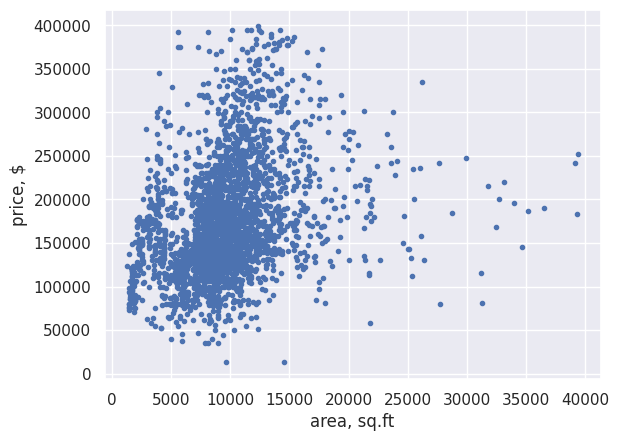

In [20]:
plt.plot(x[:, 0], y, '.')
plt.xlabel('area, sq.ft')
plt.ylabel('price, $');
plt.show()

## 3. Blobs

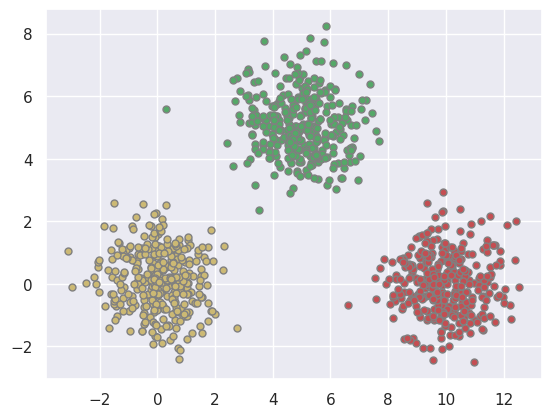

In [21]:
x, y = make_blobs(n_samples=1000, centers=[[0,0], [5,5], [10, 0]])
colors = "ygr"
for i, color in enumerate(colors):
    idx = y == i
    plt.scatter(x[idx, 0], x[idx, 1], c=color, edgecolor='gray', s=25)
plt.show()

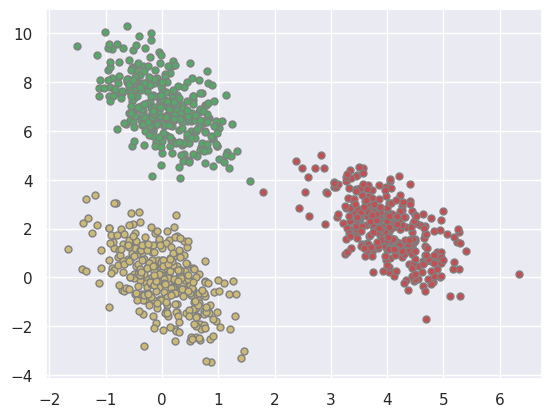

In [22]:
x, y = make_blobs(n_samples=1000, centers=[[0,0], [5,5], [10, 0]])

transformation = [[0.4, 0.2], [-0.4, 1.2]]  # affine transformation matrix
x = np.dot(x, transformation)               # applied to point coordinated to make blobs less separable

colors = "ygr"
for i, color in enumerate(colors):
    idx = y == i
    plt.scatter(x[idx, 0], x[idx, 1], c=color, edgecolor='gray', s=25)
plt.show()



## 4. Fashion MNIST

`Fashion-MNIST` is a dataset of Zalando's article images—consisting of a training set of 60,000 examples and a test set of 10,000 examples. Each example is a 28x28 grayscale image, associated with a label from 10 classes. (from https://github.com/zalandoresearch/fashion-mnist)

In [23]:
fashion_mnist = tf.keras.datasets.fashion_mnist
(train_images, train_labels), (test_images, test_labels) = fashion_mnist.load_data()

In [24]:
fmnist_class_names = ['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat',
               'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']

Each of the training and test examples is assigned to one of the following labels:

| Label | Description |
| --- | --- |
| 0 | T-shirt/top |
| 1 | Trouser |
| 2 | Pullover |
| 3 | Dress |
| 4 | Coat |
| 5 | Sandal |
| 6 | Shirt |
| 7 | Sneaker |
| 8 | Bag |
| 9 | Ankle boot |

Let's check few samples:

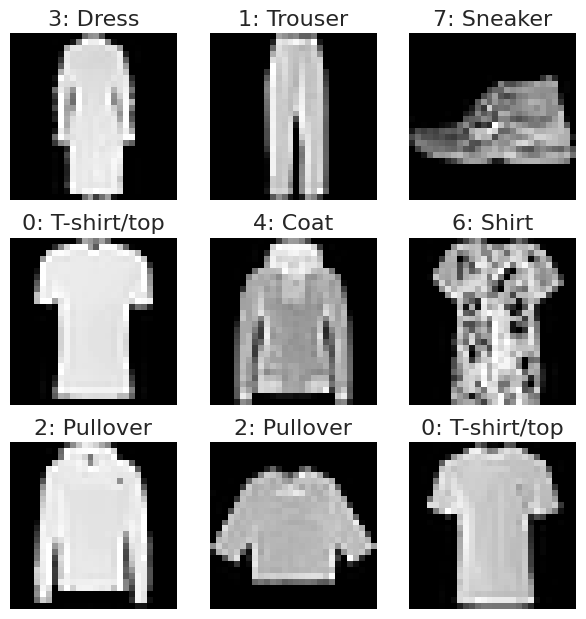

In [25]:
n = 3
fig, ax = plt.subplots(n, n, figsize=(2*n, 2*n))
ax = [ax_xy for ax_y in ax for ax_xy in ax_y]
for axi, im_idx in zip(ax, np.random.choice(len(train_images), n**2)):
  im = train_images[im_idx]
  im_class = train_labels[im_idx]
  axi.imshow(im, cmap='gray')
  axi.set_title(f'{im_class}: {fmnist_class_names[im_class]}', size=16)
  axi.grid(False)
  axi.axis('off')
plt.tight_layout(pad=0,h_pad=0.8,w_pad=0)
plt.show()

## 5. Weather dataset

This is a weather time series [dataset](https://www.bgc-jena.mpg.de/wetter/) recorded by the Max Planck Institute for Biogeochemistry 
It contains weather reacord for 8 years of observation.

In [26]:
def get_weather_df():
  # inspired by https://www.tensorflow.org/tutorials/structured_data/time_series

  # download and extract dataset
  zip_path = tf.keras.utils.get_file(
    origin='https://storage.googleapis.com/tensorflow/tf-keras-datasets/jena_climate_2009_2016.csv.zip',
    fname='jena_climate_2009_2016.csv.zip',
    extract=True)
  csv_path, _ = os.path.splitext(zip_path)

  # load into pandas df
  df = pd.read_csv(csv_path)
  
  # dataset contains records every 10 min, we use hourly records only, thus
  # slice [start:stop:step], starting from index 5 take every 6th record
  df = df[5::6]

  # replace errors in wind velocity to 0
  wv = df['wv (m/s)']
  bad_wv = wv == -9999.0
  wv[bad_wv] = 0.0

  max_wv = df['max. wv (m/s)']
  bad_max_wv = max_wv == -9999.0
  max_wv[bad_max_wv] = 0.0

  # obtain timestamps from text time format
  date_time = pd.to_datetime(df.pop('Date Time'), format='%d.%m.%Y %H:%M:%S')
  timestamp_s = date_time.map(pd.Timestamp.timestamp)
  # genarate cyclic features for year and day
  day = 24*60*60
  year = (365.2425) * day

  df['Day sin'] = np.sin(timestamp_s * (2 * np.pi / day))
  df['Day cos'] = np.cos(timestamp_s * (2 * np.pi / day))
  df['Year sin'] = np.sin(timestamp_s * (2 * np.pi / year))
  df['Year cos'] = np.cos(timestamp_s * (2 * np.pi / year))

  return df

In [27]:
weather_df = get_weather_df()

In [28]:
weather_df.head()

,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg),Day sin,Day cos,Year sin,Year cos
5,996.50,-8.05,265.38,-8.78,94.4,3.33,3.14,0.19,1.96,3.15,1307.86,0.21,0.63,192.7,0.258819,0.965926,0.010049,0.999950
11,996.62,-8.88,264.54,-9.77,93.2,3.12,2.90,0.21,1.81,2.91,1312.25,0.25,0.63,190.3,0.500000,0.866025,0.010766,0.999942
17,996.84,-8.81,264.59,-9.66,93.5,3.13,2.93,0.20,1.83,2.94,1312.18,0.18,0.63,167.2,0.707107,0.707107,0.011483,0.999934
23,996.99,-9.05,264.34,-10.02,92.6,3.07,2.85,0.23,1.78,2.85,1313.61,0.10,0.38,240.0,0.866025,0.500000,0.012199,0.999926
29,997.46,-9.63,263.72,-10.65,92.2,2.94,2.71,0.23,1.69,2.71,1317.19,0.40,0.88,157.0,0.965926,0.258819,0.012916,0.999917


In [29]:
weather_df.describe().T

,count,mean,std,min,25%,50%,75%,max
p (mbar),70091.0,989.212842,8.358886,913.60,984.200000,9.895700e+02,994.720000,1015.29
T (degC),70091.0,9.450482,8.423384,-22.76,3.350000,9.410000e+00,15.480000,37.28
Tpot (K),70091.0,283.493086,8.504424,250.85,277.440000,2.834600e+02,289.530000,311.21
Tdew (degC),70091.0,4.956471,6.730081,-24.80,0.240000,5.210000e+00,10.080000,23.06
rh (%),70091.0,76.009788,16.474920,13.88,65.210000,7.930000e+01,89.400000,100.00
VPmax (mbar),70091.0,13.576576,7.739883,0.97,7.770000,1.182000e+01,17.610000,63.77
VPact (mbar),70091.0,9.533968,4.183658,0.81,6.220000,8.860000e+00,12.360000,28.25
VPdef (mbar),70091.0,4.042536,4.898549,0.00,0.870000,2.190000e+00,5.300000,46.01
sh (g/kg),70091.0,6.022560,2.655812,0.51,3.920000,5.590000e+00,7.800000,18.07
H2OC (mmol/mol),70091.0,9.640437,4.234862,0.81,6.290000,8.960000e+00,12.490000,28.74


In [30]:
# plt.plot(weather_df['Year cos'])
# plt.plot(weather_df['Year sin'])

In [31]:
# plt.plot(weather_df['Day cos'][:7*24])
# plt.plot(weather_df['Day sin'][:7*24])

In [32]:
def gen_future_T_dataset(X_len=24, Y_offset=48,
                         X_features=['p (mbar)', 'T (degC)', 'rh (%)', 'wv (m/s)', 'wd (deg)', 'Day sin', 'Day cos', 'Year sin', 'Year cos'],
                         Y_features='T (degC)',
                         standardize=True,
                         oversample=10
                         ):
  """
  Generates pairs of input-label, using sequence of `X_len` samples as input
  and value at offset `Y_offset` from start of this sequence as label.
  Sample sequnces arte taken at random positions throughout the dataset.
  Number of samples is obtained assuming non-overlaping wondows.
  Oversampling factor allows to increase this value.

  Args:
    X_len (int): length of sample sequence
    Y_offset (int): offset to the target value from the sequence start
    X_features (list or str): features to be used as input
    Y_features (list or str): features to be used as labels
    standardize (Bool): flag whether to standardize the columns
    oversample (int): increases number of samples by this factor wrt baseline
                      n = len(df) // (Y_offset+1)
  """
  weather_df = get_weather_df()

  if standardize:
    mean = weather_df.mean()
    std = weather_df.std()
    weather_df = (weather_df - mean) / std
  
  df_X = weather_df[X_features]
  df_Y = weather_df[Y_features]

  n_records = len(df_X)
  sample_len = Y_offset+1
  n_samples = int((n_records-sample_len)//sample_len*oversample)
  offsets = np.random.randint(0, n_records-sample_len, size=n_samples)
  offsets.sort()

  X = []
  Y = []
  for o in offsets:
    X.append(np.array(df_X[o:o+X_len]))
    Y.append(np.array(df_Y[o+Y_offset:o+Y_offset+1]))

  X = np.stack(X)
  Y = np.concatenate(Y)

  return X, Y

In [33]:
x, y = gen_future_T_dataset()

In [34]:
x.shape, y.shape

((14290, 24, 9), (14290,))

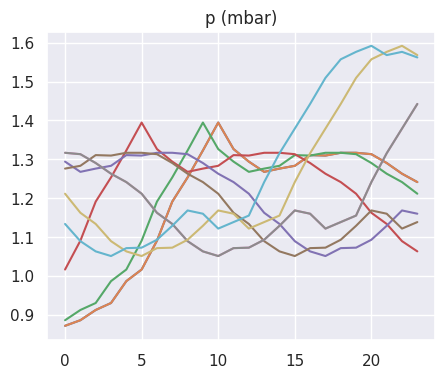

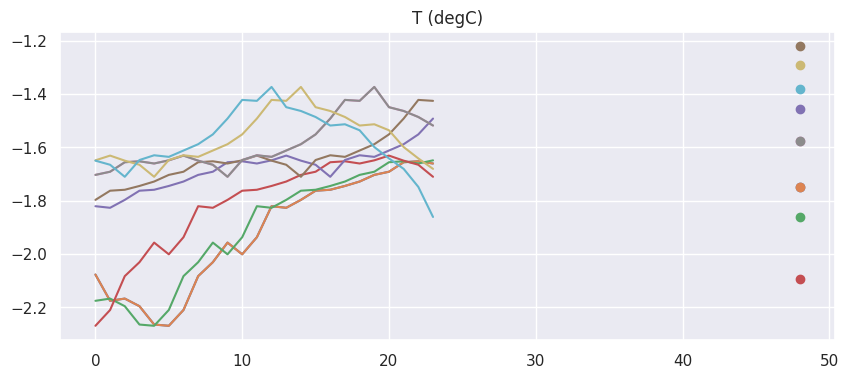

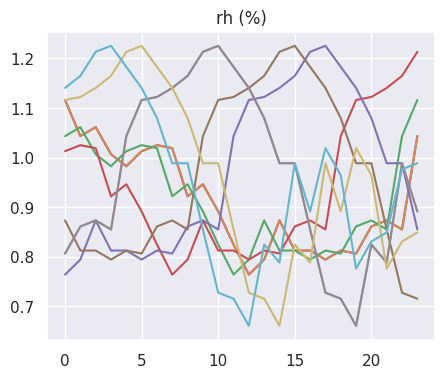

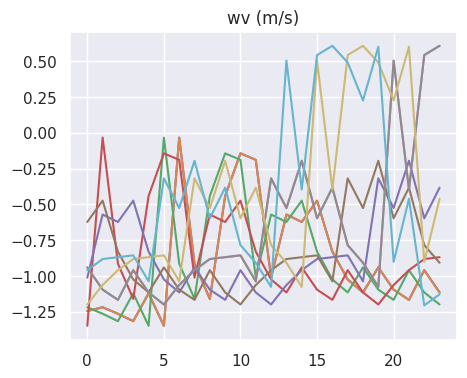

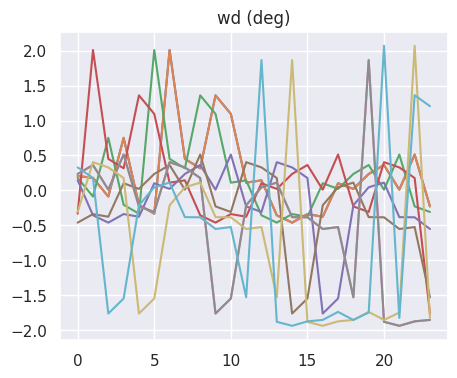

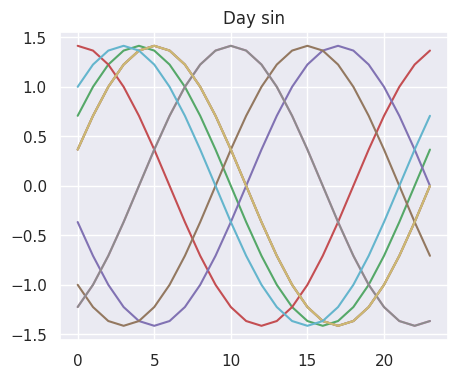

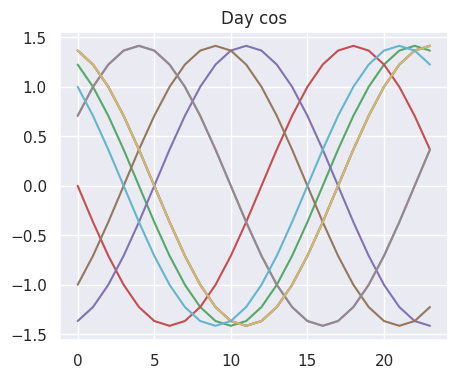

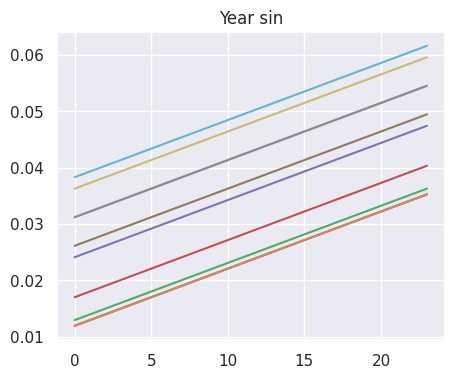

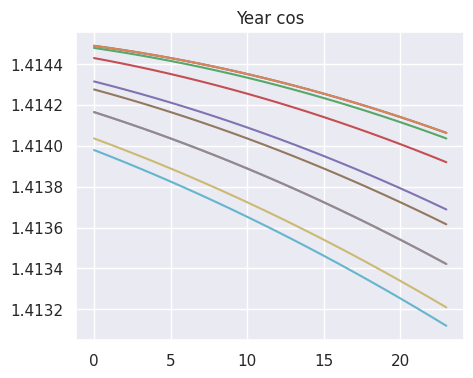

In [35]:
for f,fn in enumerate(['p (mbar)', 'T (degC)', 'rh (%)', 'wv (m/s)', 'wd (deg)', 'Day sin', 'Day cos', 'Year sin', 'Year cos']):
  plt.figure(figsize=(5*(1+(f==1)), 4))
  for s in range(10):
    plt.plot(x[s, :, f])
    if f==1:
      plt.scatter(48, y[s], color=plt.gca().lines[-1].get_color())
  plt.title(fn)
  plt.show()

# `scikit-learn` interface

In this course we will primarily use the `scikit-learn` module.
You can find extensive documentation with examples in the [user guide](https://scikit-learn.org/stable/user_guide.html)

The module contains A LOT of different machine learning methods, and here we will cover only few of them. What is great about `scikit-learn` is that it has a uniform and consistent interface. 

All the different ML approaches are implemented as classes with a set of same main methods:

1. `fitter = ...`: Create fitter object.
2. `fitter.fit(x, y[, sample_weight])`: Fit model to predict from list of smaples `x` a list of target values `y`.
3. `y_pred = fitter.predict(X)`: Predict using the trained model.
4. `s = fitter.score(x, y[, sample_weight])`: Obtain a relevant performance measure of the trained model.

This allows one to easily replace one approach with another and find the best one for the problem at hand, by simply using a regression/classification object of another class, while the rest of the code can remain the same.


It is useful to know that generally in scikit-learn the input data is represented as a matrix $X$ of dimensions `n_samples x n_features` , whereas the supervised labels/values are stored in a matrix $Y$ of dimensions `n_samples x n_target` .

# 1.Regression and Classification

## 1.Linear models

In many cases the scalar value of interest - dependent variable - is (or can be approximated as) linear combination of the independent variables. 

In linear regression the estimator is searched in the form: $$\hat{y}(\bar{x} | \bar{w}) = w_0 + w_1 x_1 + ... + w_p x_p$$

The parameters $\bar{w} = (w_1,..., w_p)$ and $w_0$ are designated as `coef_` and `intercept_` in `sklearn`.

Reference: https://scikit-learn.org/stable/modules/linear_model.html

### 1. Linear regression

[LinearRegression](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LinearRegression.html) fits a linear model with coefficients $\bar{w} = (w_1,..., w_p)$ and $w_0$ to minimize the residual sum of squares between the observed targets in the dataset, and the targets predicted by the linear approximation.

Mathematically it solves a problem of the form:  $$\bar{w} = \min_{w_i} || \bar{X} \cdot \bar{w} - y||_2^2$$

true slopes: w = [9.37682244] ;  b = 8.35869365562366


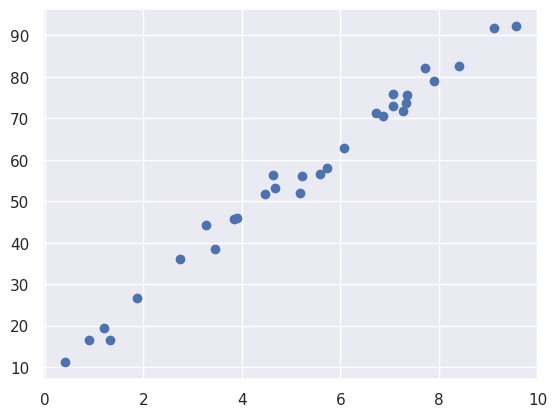

In [36]:
x, y = get_linear(n_d=1, sigma=3, n_points=30)  # p==1, 1D input
plt.scatter(x, y);
plt.show()

In [37]:
reg = linear_model.LinearRegression()
reg.fit(x, y)

LinearRegression()

In [38]:
w, w0 = reg.coef_, reg.intercept_
print(w, w0)

[8.93406926] 9.520304739034039


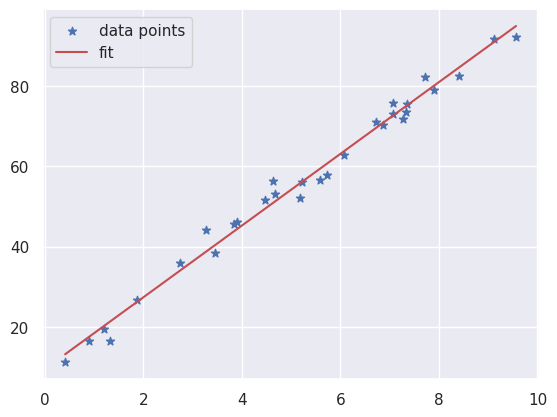

In [39]:
plt.scatter(x, y, marker='*', label='data points')
x_f = np.linspace(x.min(), x.max(), 10)
y_f = w0 + w[0] * x_f
plt.plot(x_f, y_f, label='fit', c='r')
plt.legend()
plt.show()

In [40]:
# rmse
np.std(y - reg.predict(x))  # or use metrics.mean_squared_error(..., squared=False)

2.5367584910976504

In [41]:
# R2
reg.score(x, y) 

0.9871508636699147

Let's try 2D input. 
Additionally, here we will split the whole dataset into training and test subsets using the `train_test_split` function:

true slopes: w = [7.06739215 2.55796647] ;  b = 9.01187020988695


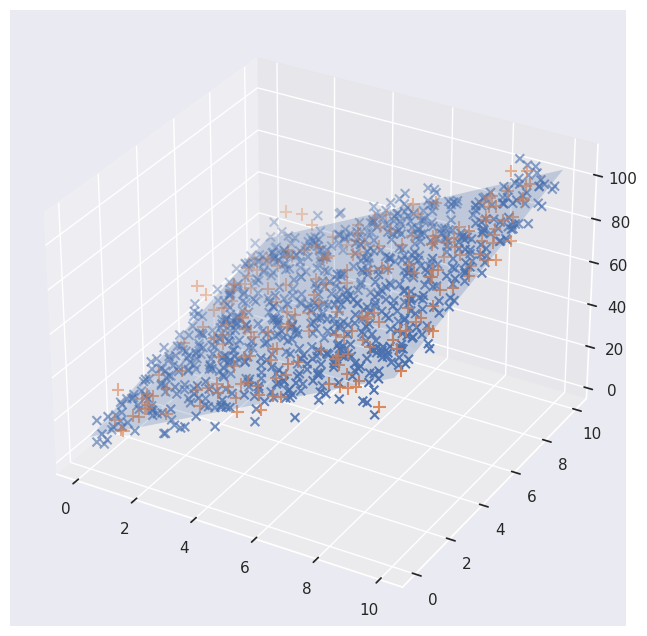

In [42]:
n_d = 2
x, y = get_linear(n_d=n_d, n_points=1000, sigma=5)

# train test split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2)

reg = linear_model.LinearRegression()
reg.fit(x_train, y_train)


fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x_train[:,0], x_train[:,1], y_train, marker='x', s=40)
ax.scatter(x_test[:,0], x_test[:,1], y_test, marker='+', s=80)

xx0 = np.linspace(x[:,0].min(), x[:,0].max(), 10)
xx1 = np.linspace(x[:,1].min(), x[:,1].max(), 10)
xx0, xx1 = [a.flatten() for a in np.meshgrid(xx0, xx1)]
xx = np.stack((xx0, xx1), axis=-1)
yy = reg.predict(xx)
ax.plot_trisurf(xx0, xx1, yy, alpha=0.25, linewidth=0)
plt.show()

In [43]:
# rmse
print('train rmse =', np.std(y_train - reg.predict(x_train)))
print('test rmse =', np.std(y_test - reg.predict(x_test)))

train rmse = 5.034245963271906
test rmse = 5.058672185372639


In [44]:
# R2
print('train R2 =', reg.score(x_train, y_train))
print('test R2 =', reg.score(x_test, y_test))

train R2 = 0.9486669257639501
test R2 = 0.94651567815176


### EXERCISE 1.

Use linear regression to fit house prices dataset.

In [45]:
# 1. make train/test split

# 2. fit the model

# 3. evaluate RMSE, MAD, and R2 on train and test datasets

# 4. plot y vs predicted y for test and train parts

### 2. Logistic regression

Logistic regression, despite its name, is a linear model for classification rather than regression. In this model, the probabilities describing the possible outcomes of a single trial are modeled using a logistic function.

In binary logistic regression the probability $p$ of a point belonging to a class is modeled as: $$\frac{p}{1-p} = e^{w_0 + w_1 x_1 + ... + w_p x_p}$$

\\
In case of $N$ classes 2 options are available: 
* One-versus-rest (`ovr`) performs $N$ independent binary logistic regressions for each class $i$ just as for the binary case: $$\frac{p_i}{1-p_i} = e^{w_{i0} + w_{i1} x_1 + ... + w_{ip} x_p}$$
Final probability is obtained by evaluating the probability for all classes, and then normalizing it: $$\hat p_i = \frac{p_i}{\sum_j{p_j}}$$

\\
* Multinimial (`multinomial`) logistic regression fits probability for each class $i$ with respect to a pivot, e.g. class $0$:
$$\frac{p_i}{p_0} = e^{w_{i0} + w_{i1} x_1 + ... + w_{ip} x_p},\, i\neq0$$
Then softmax function is used to find the predicted probability of each class.

\\
The binary class $\ell_2$-penalized logistic regression minimizes the following cost function:
$$\min_{w, c}  \sum_{i=1}^n \log(\exp(- y_i (X_i^T w + c)) + 1) + \lambda \frac{1}{2}w^T w$$.

In [46]:
# routine for coloring 2d space according to class prediction

def plot_prediction_2d(x_min, x_max, y_min, y_max, classifier, ax=None):
  """
  Creates 2D mesh, predicts class for each point on the mesh, and visualises it
  """

  mesh_step = .02  # step size in the mesh
  x_coords = np.arange(x_min, x_max, mesh_step) # coordinates of mesh colums
  y_coords = np.arange(y_min, y_max, mesh_step) # coordinates of mesh rows
  
  # create mesh, and get x and y coordinates of each point point
  # arrenged as array of shape (n_mesh_rows, n_mesh_cols)
  mesh_nodes_x, mesh_nodes_y = np.meshgrid(x_coords, y_coords)

  # Plot the decision boundary. For that, we will assign a color to each
  # point in the mesh [x_min, x_max]x[y_min, y_max].

  # prepare xy pairs for prediction: matrix of size (n_mesh_rows*n_mesh_cols, 2)
  mesh_xy_coords = np.stack([mesh_nodes_x.flatten(), 
                             mesh_nodes_y.flatten()], axis=-1)
  
  # obtain class for each node
  mesh_nodes_class = classifier.predict(mesh_xy_coords)
  
  # reshape to the shape (n_mesh_rows, n_mesh_cols)==mesh_nodes_x.shape for visualization
  mesh_nodes_class = mesh_nodes_class.reshape(mesh_nodes_x.shape)
  
  # Put the result into a color countour plot
  ax = ax or plt.gca()
  ax.contourf(mesh_nodes_x,
              mesh_nodes_y,
              mesh_nodes_class,
              cmap='Pastel1', alpha=0.5)

In [47]:
# routine for plotting 3d probability hyperplanes

def plot_hyperplanes_3d(x_min, x_max, y_min, y_max, classifier):
  """
  Creates 2D mesh, predicts class for each point on the mesh, and visualises it
  """

  mesh_step = .5  # step size in the mesh
  x_coords = np.arange(x_min, x_max, mesh_step) # coordinates of mesh colums
  y_coords = np.arange(y_min, y_max, mesh_step) # coordinates of mesh rows
  
  # create mesh, and get x and y coordinates of each point point
  # arrenged as array of shape (n_mesh_rows, n_mesh_cols)
  mesh_nodes_x, mesh_nodes_y = np.meshgrid(x_coords, y_coords)

  # Plot the decision boundary. For that, we will assign a color to each
  # point in the mesh [x_min, x_max]x[y_min, y_max].

  # prepare xy pairs for prediction: matrix of size (n_mesh_rows*n_mesh_cols, 2)
  mesh_xy_coords = np.stack([mesh_nodes_x.flatten(), 
                             mesh_nodes_y.flatten()], axis=-1)
  
  # obtain class for each node
  coef = classifier.coef_
  intercept = classifier.intercept_

  df_dict = {
      'x':[],
      'y':[],
      'p':[],
      'c':[]
  }
  def fill_dict(x, y, p, c):
    df_dict['x'].append(x)
    df_dict['y'].append(y)
    df_dict['p'].append(p)
    df_dict['c'].append(c)

  for c in classifier.classes_:
    coef_c = coef[c]
    intercept_c = intercept[c]
    for x, y in mesh_xy_coords:
      p = x*coef_c[0] + y*coef_c[1] + intercept_c
      fill_dict(x, y, p, c)
  df = pd.DataFrame(df_dict)
  fig = px.scatter_3d(df, x='x', y='y', z='p', color='c', size_max=1)
  fig.show()

training accuracy : 0.995 (multinomial)


<ipython-input-48-b399dba9259b>:35: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


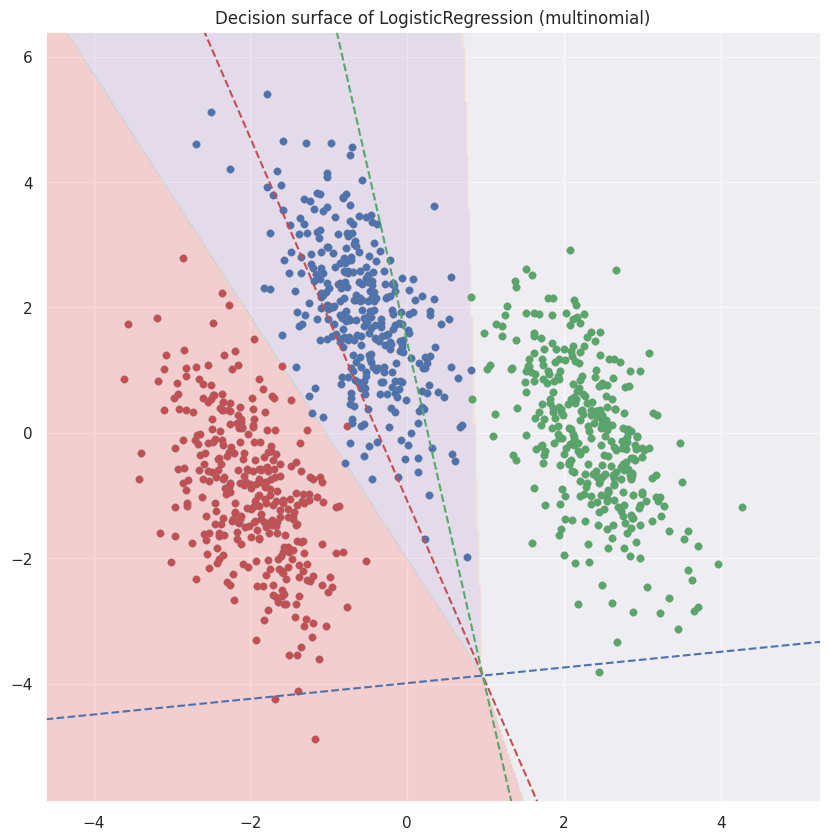

In [48]:
# make 3-class dataset for classification
centers = [[-5, 0], [0, 1.5], [5, -1]]
x, y = make_blobs(n_samples=1000, centers=centers, random_state=40)
transformation = [[0.4, 0.2], [-0.4, 1.2]]
x = np.dot(x, transformation)

multi_class = 'multinomial'
# do fit
clf = linear_model.LogisticRegression(solver='sag', max_iter=100,
                          multi_class=multi_class, )
clf.fit(x, y)

# print the training scores
print("training accuracy : %.3f (%s)" % (clf.score(x, y), multi_class))

# get range for visualization
x_0 = x[:, 0]
x_1 = x[:, 1]
x_min = x_0.min() - 1
x_max = x_0.max() + 1
y_min = x_1.min() - 1
y_max = x_1.max() + 1

plt.figure(figsize=(10,10))
plot_prediction_2d(x_min, x_max, y_min, y_max, classifier=clf)

plt.title("Decision surface of LogisticRegression (%s)" % multi_class)
plt.axis('tight')

# Plot also the training points
colors = 'rbg'

for i, color in zip(clf.classes_, colors):
    idx = np.where(y == i)
    plt.scatter(x_0[idx], x_1[idx], c=color, cmap=plt.cm.Paired, 
                edgecolor='gray', s=30, linewidth=0.2)

# Plot the three one-against-all classifiers
coef = clf.coef_
intercept = clf.intercept_

def plot_hyperplane(c, color):
    def line(x0):
        return (-(x0 * coef[c, 0]) - intercept[c]) / coef[c, 1]
    plt.plot([x_min, x_max], [line(x_min), line(x_max)],
              ls="--", color=color)

for i, color in zip(clf.classes_, colors):
    plot_hyperplane(i, color)

plt.show()
#plot_hyperplanes_3d(x_min, x_max, y_min, y_max, classifier=clf)


### EXERCISE 2.

In [49]:
fashion_mnist = tf.keras.datasets.fashion_mnist
(train_images, train_labels), (test_images, test_labels) = fashion_mnist.load_data()

We will reshape 2-d images to 1-d arrays for use in scikit-learn:

In [50]:
n_train = len(train_labels)
x_train = train_images.reshape((n_train, -1))
y_train = train_labels

n_test = len(test_labels)
x_test = test_images.reshape((n_test, -1))
y_test = test_labels

Now use a multinomial logistic regression classifier, and measure the accuracy:

In [51]:
# 1. Create classifier

# 2. fit the model

# 3. evaluate accuracy on train and test datasets

## 2. Trees & Forests

### 1. Decision Tree

Decision Trees are a non-parametric supervised learning method used for classification and regression. The goal is to create a model that predicts the value of a target variable by learning **simple** decision rules inferred from the data features.

They are fast to train, easily interpretable, capture non-linear dependencies, and require small amount of data.

training score : 0.667 (depth=1)


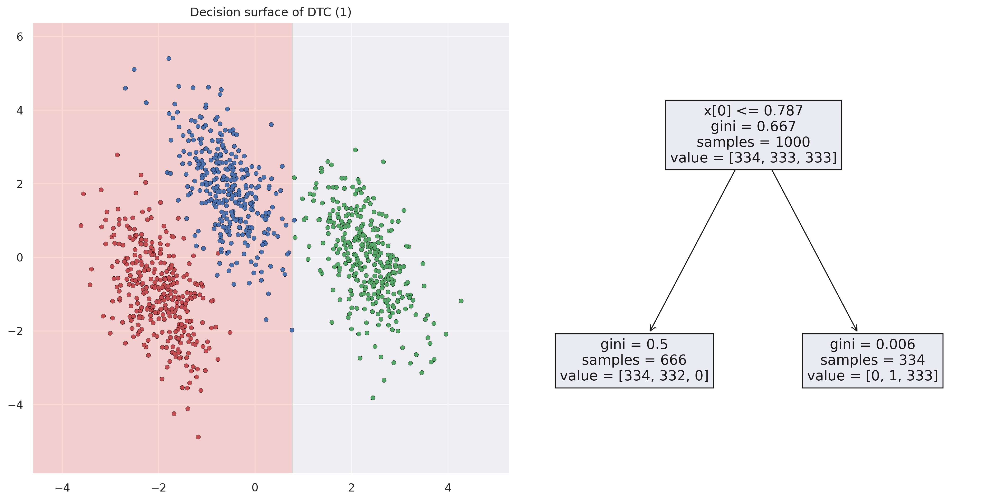

training score : 0.942 (depth=2)


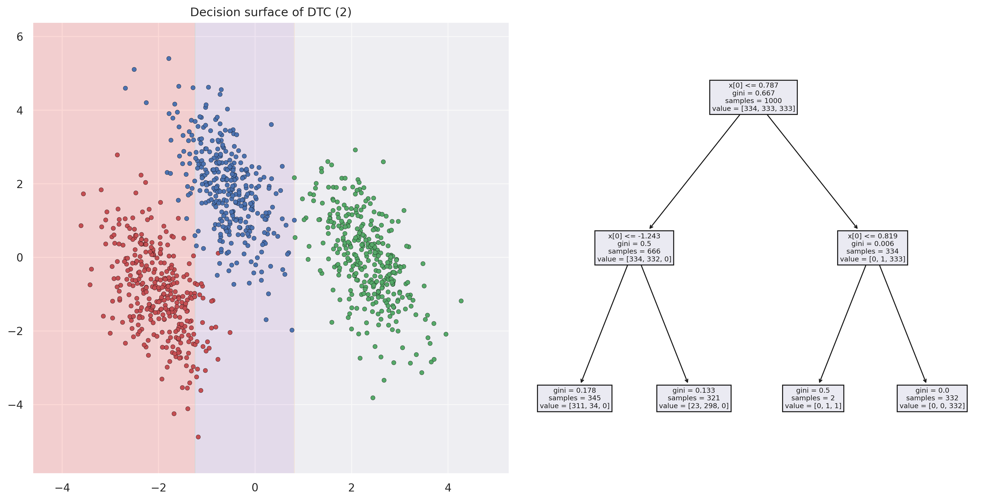

training score : 0.987 (depth=3)


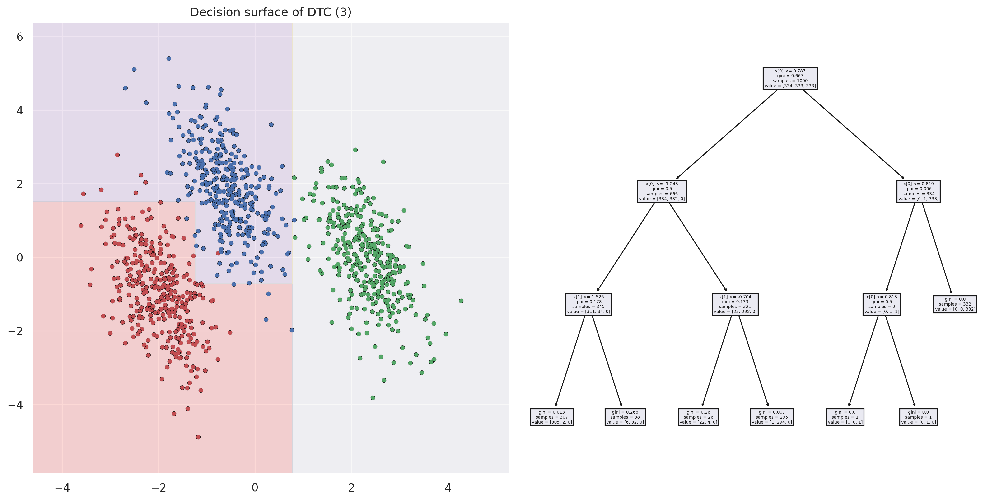

training score : 0.995 (depth=4)


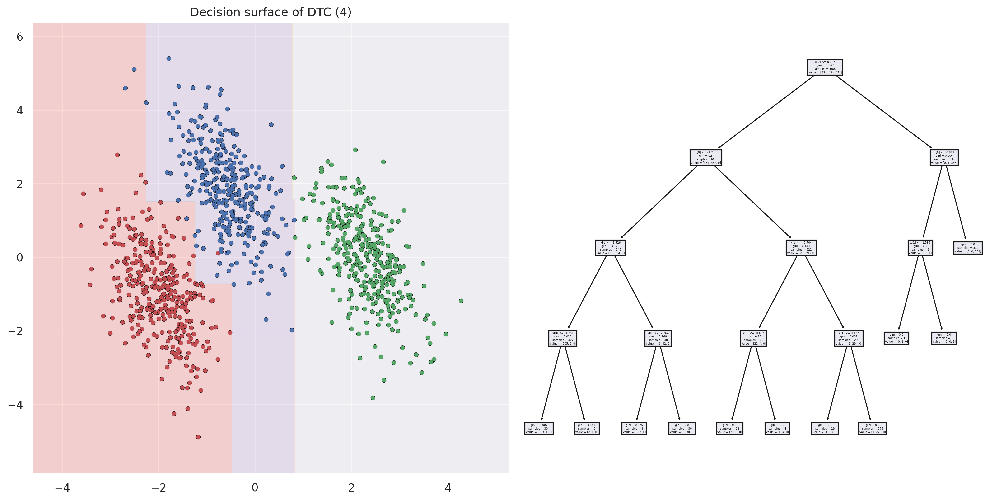

In [52]:
# make 3-class dataset for classification
centers = [[-5, 0], [0, 1.5], [5, -1]]
X, y = make_blobs(n_samples=1000, centers=centers, random_state=40)
transformation = [[0.4, 0.2], [-0.4, 1.2]]
X = np.dot(X, transformation)
dtcs = []
for depth in (1, 2, 3, 4):
    # do fit
    dtc = tree.DecisionTreeClassifier(max_depth=depth, criterion='gini')  # 'entropy'
    dtcs.append(dtc)
    dtc.fit(X, y)

    # print the training scores
    print("training score : %.3f (depth=%d)" % (dtc.score(X, y), depth))

    # get range for visualization
    x_0 = X[:, 0]
    x_1 = X[:, 1]
    x_min = x_0.min() - 1
    x_max = x_0.max() + 1
    y_min = x_1.min() - 1
    y_max = x_1.max() + 1

    fig, ax = plt.subplots(1, 2,  figsize=(14,7), dpi=300)
    plot_prediction_2d(x_min, x_max, y_min, y_max, classifier=dtc, ax=ax[0])
    
    ax[0].set_title("Decision surface of DTC (%d)" % depth)
    
    # Plot also the training points
    colors = "rbg"
    for i, color in zip(dtc.classes_, colors):
        idx = np.where(y == i)
        ax[0].scatter(x_0[idx], x_1[idx], c=color,
                    edgecolor='black', s=20, linewidth=0.2)

    with plt.style.context('classic'):
      tree.plot_tree(dtc, ax=ax[1]);

    plt.tight_layout(pad=0.5, h_pad=0)
    plt.show()

Given fraction of samples of class $i$ as $p_i$

* the Gini index is:
$$G = 1 - \sum_i {p_i^2}, $$

* the Entropy is:
$$E =  - \sum_i {p_i * log(p_i)}, $$

The optimization is performed in a greedy manner, one split at a time, minimizing impurity in the descendant nodes $G=G_1+G_2$ when the Gini index is used, or maximizing informatin gain: $IG = E_{node} - E_1 - E_2$

In [53]:
text_representation = tree.export_text(dtcs[2])
print(text_representation)

|--- feature_0 <= 0.79
|   |--- feature_0 <= -1.24
|   |   |--- feature_1 <= 1.53
|   |   |   |--- class: 0
|   |   |--- feature_1 >  1.53
|   |   |   |--- class: 1
|   |--- feature_0 >  -1.24
|   |   |--- feature_1 <= -0.70
|   |   |   |--- class: 0
|   |   |--- feature_1 >  -0.70
|   |   |   |--- class: 1
|--- feature_0 >  0.79
|   |--- feature_0 <= 0.82
|   |   |--- feature_0 <= 0.81
|   |   |   |--- class: 2
|   |   |--- feature_0 >  0.81
|   |   |   |--- class: 1
|   |--- feature_0 >  0.82
|   |   |--- class: 2



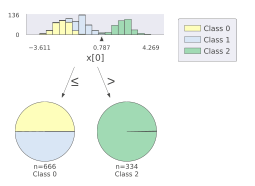

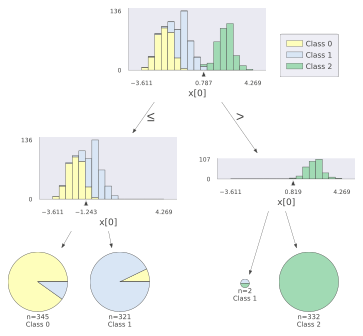

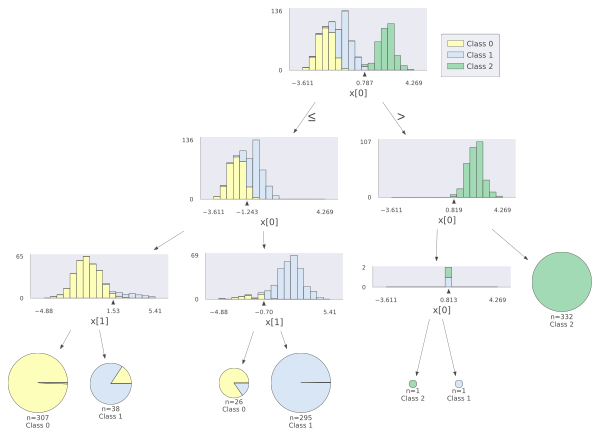

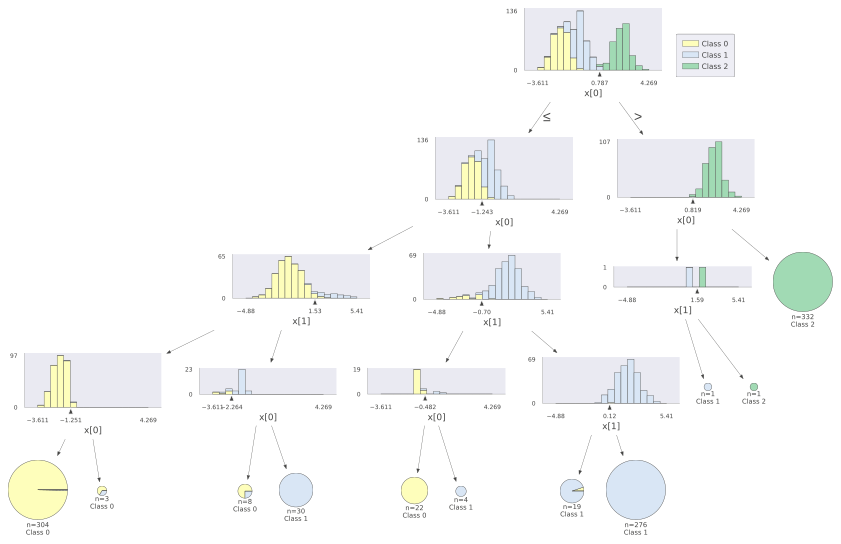

In [54]:
for i, dtc in enumerate(dtcs):
  viz_model = dtreeviz.model(dtc,
                           X_train=X, y_train=y,
                           feature_names=['x[0]', 'x[1]'])

  v = viz_model.view()     # render as SVG into internal object 
  fn = f'tree_{i}.svg'
  v.save(fn)
  display(v)

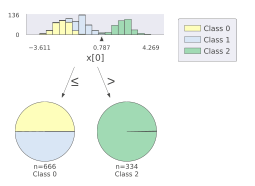

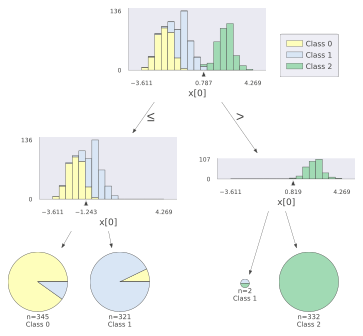

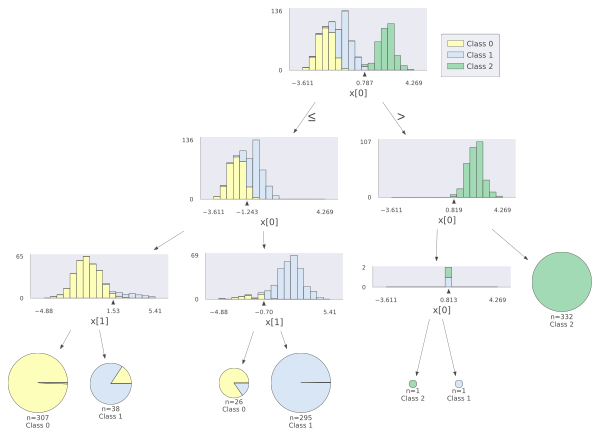

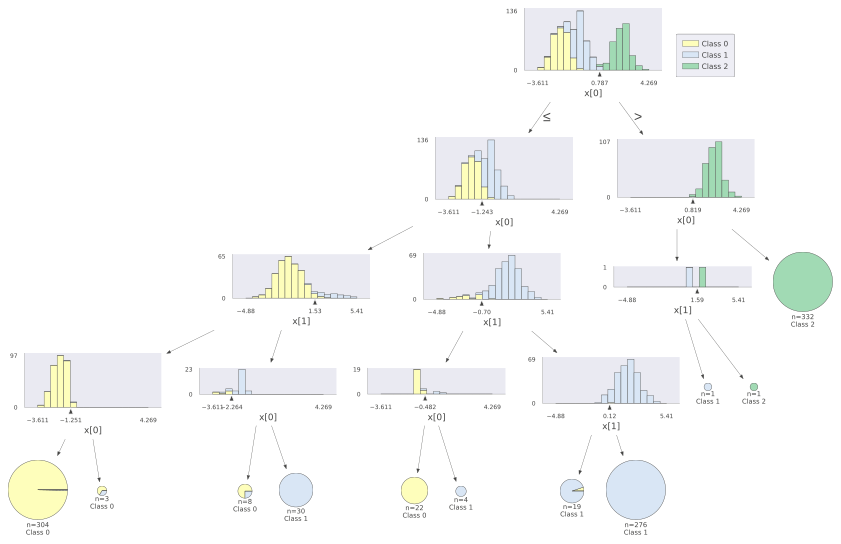

In [55]:
for i, dtc in enumerate(dtcs):
  fn = f'tree_{i}.svg'
  display(SVG(fn))

Additionally we can directly inspect relevance of the input features for the classification (impurity based):

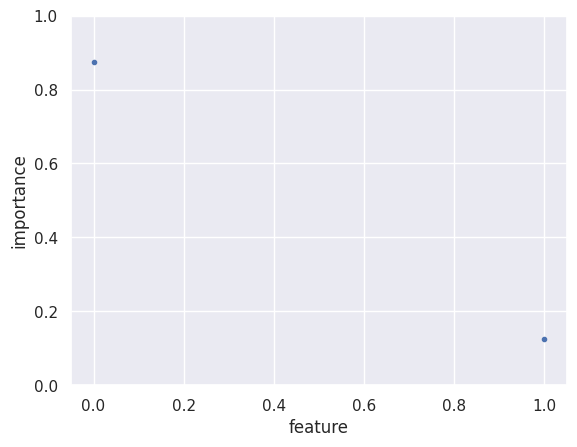

In [56]:
plt.plot(dtcs[2].feature_importances_, '.')
plt.xlabel('feature')
plt.ylabel('importance')
plt.ylim(0, 1);

### 2. Random Forest

The `sklearn.ensemble` provides several ensemble algorithms. RandomForest is an averaging algorithm based on randomized decision trees. This means a diverse set of classifiers is created by introducing randomness in the classifier construction. The prediction of the ensemble is given as the averaged prediction of the individual classifiers.

Individual decision trees typically exhibit high variance and tend to overfit.
In random forests:
* each tree in the ensemble is built from a sample drawn with replacement (i.e., a bootstrap sample) from the training set.
* when splitting each node during the construction of a tree, the best split is found from a random subset of features, according to `max_features` parameter.

The injected randomness in forests yield decision trees with somewhat decoupled prediction errors. By taking an average of those predictions, some errors can cancel out. Random forests achieve a reduced variance by combining diverse trees, sometimes at the cost of a slight increase in bias. In practice the variance reduction is often significant, hence yielding an overall better model.


training score : 0.991 (n_est=1)


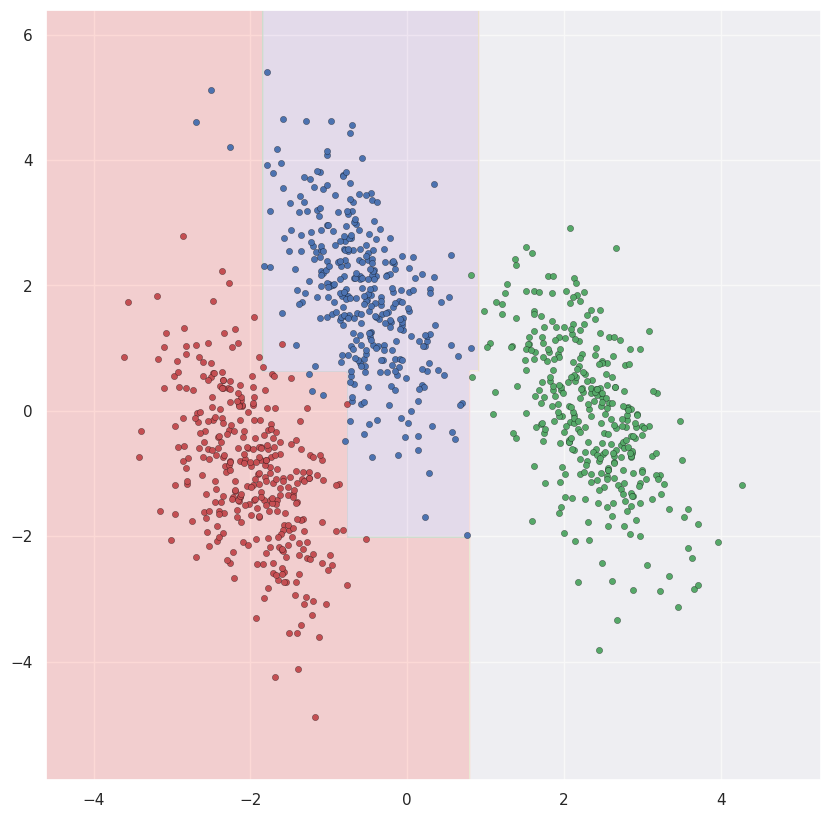

training score : 0.997 (n_est=4)


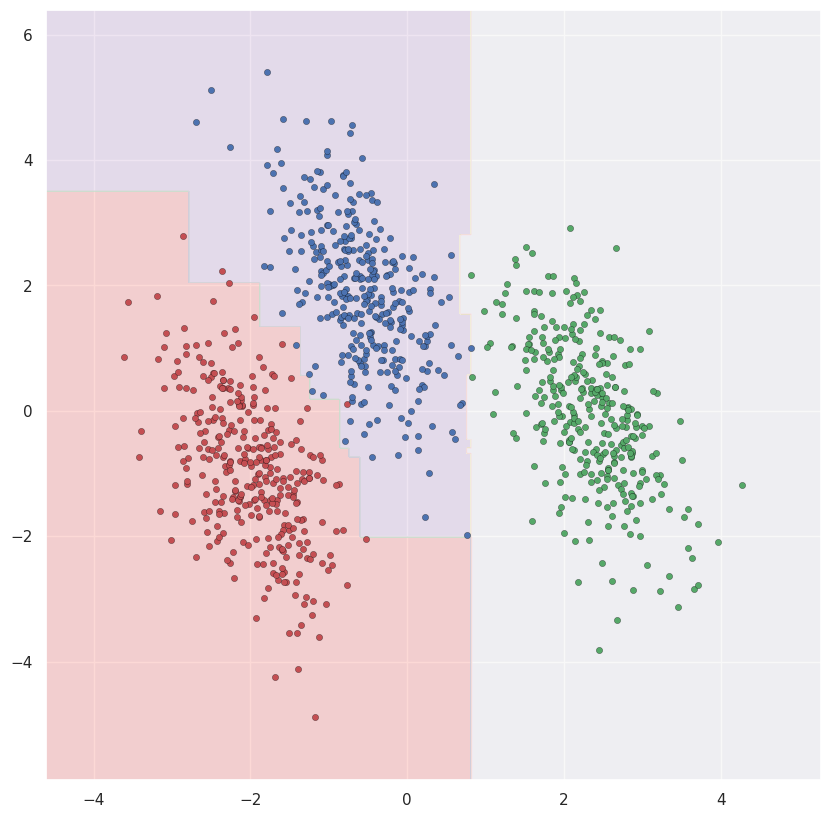

training score : 0.996 (n_est=50)


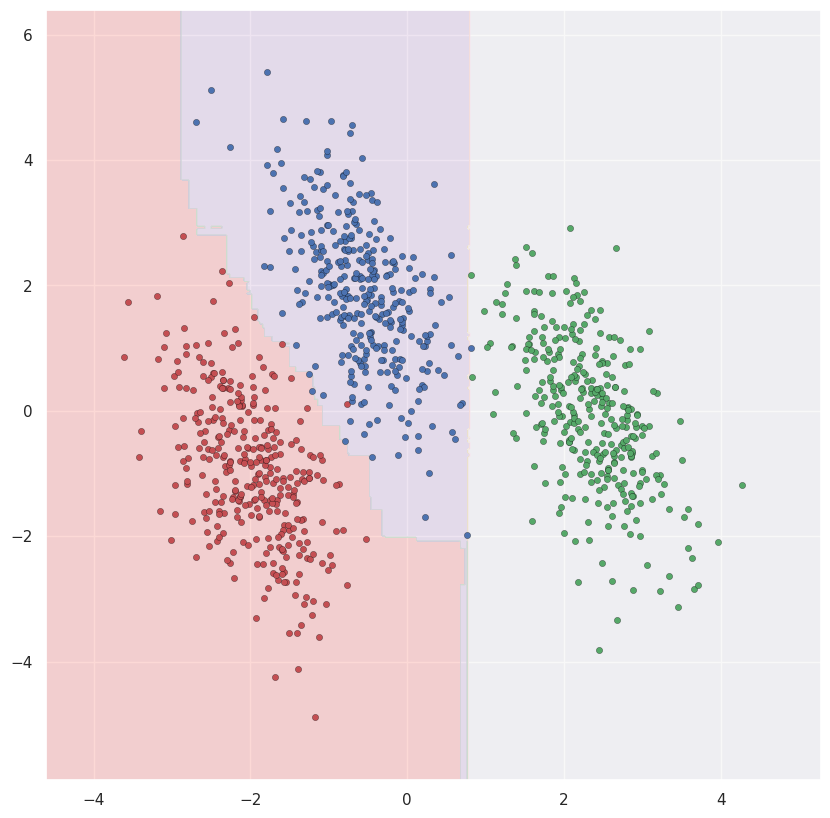

In [57]:
# make 3-class dataset for classification
centers = [[-5, 0], [0, 1.5], [5, -1]]
X, y = make_blobs(n_samples=1000, centers=centers, random_state=40)
transformation = [[0.4, 0.2], [-0.4, 1.2]]
X = np.dot(X, transformation)

for n_est in (1, 4, 50):
    # do fit
    rfc = ensemble.RandomForestClassifier(max_depth=4, n_estimators=n_est,)
    rfc.fit(X, y)

    # print the training scores
    print("training score : %.3f (n_est=%d)" % (rfc.score(X, y), n_est))

    # get range for visualization
    x_0 = X[:, 0]
    x_1 = X[:, 1]
    x_min = x_0.min() - 1
    x_max = x_0.max() + 1
    y_min = x_1.min() - 1
    y_max = x_1.max() + 1

    plt.figure(figsize=(10,10))
    plot_prediction_2d(x_min, x_max, y_min, y_max, classifier=rfc)

    # Plot also the training points
    colors = 'rbg'
    for i, color in enumerate(colors):
        idx = np.where(y == i)
        plt.scatter(x_0[idx], x_1[idx], c=color,
                    edgecolor='black', s=20, linewidth=0.2)
    
    # Plot the three one-against-all classifiers
    xmin, xmax = plt.xlim()
    ymin, ymax = plt.ylim()


    plt.show()

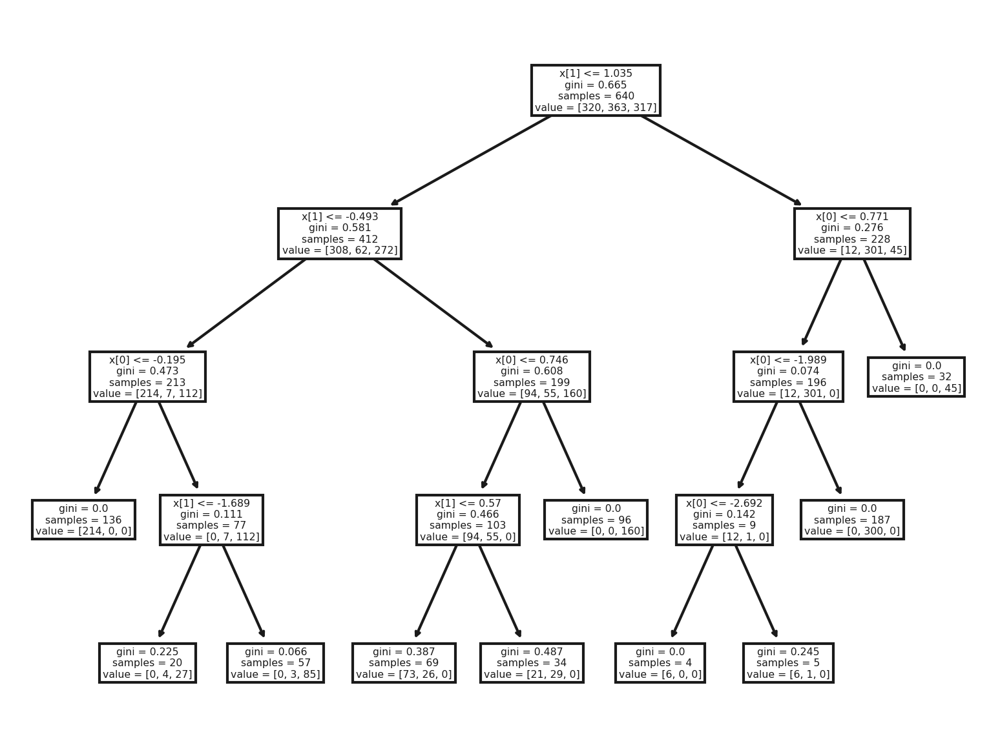

In [58]:
plt.figure(dpi=300)
with plt.style.context('classic'):
  tree.plot_tree(rfc.estimators_[20]);

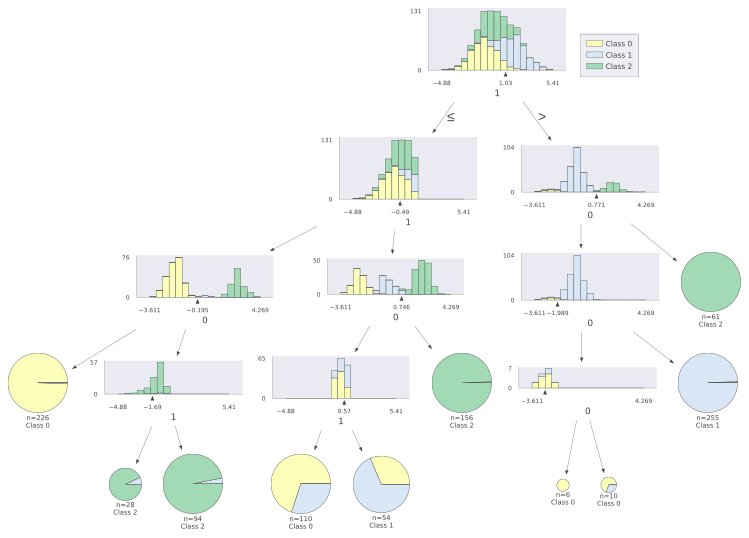

In [59]:
viz_model = dtreeviz.model(rfc.estimators_[20], X, y, feature_names=[f'{i}' for i in np.arange(len(X[0]))])

v = viz_model.view()     # render as SVG into internal object 
display(v)

For a forest we can also evaluate the feature importance:

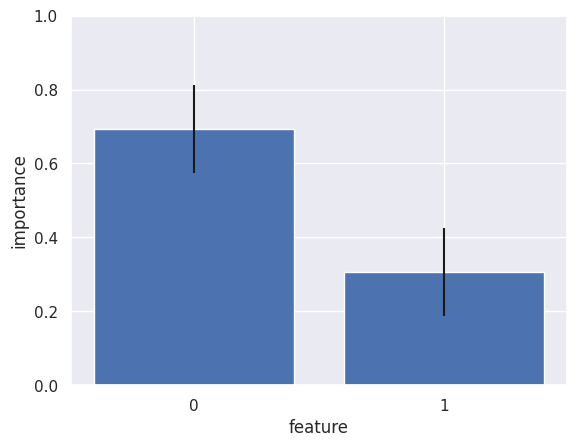

In [60]:
importances = np.array([e.feature_importances_ for e in rfc.estimators_])

#plt.plot(importances.T, '.')
plt.bar(['0', '1'], importances.mean(axis=0), yerr=importances.std(axis=0))
plt.xlabel('feature')
plt.ylabel('importance')
plt.ylim(0, 1);

Alternatively we can use permutation to study feature importance. 
It evaluates decrease in performance (model's `.score` or specified in `scoring` parameter) for each variable when its values is shuffled between samples. 
It can be time-consuming as requires re-evaluation for each feature:

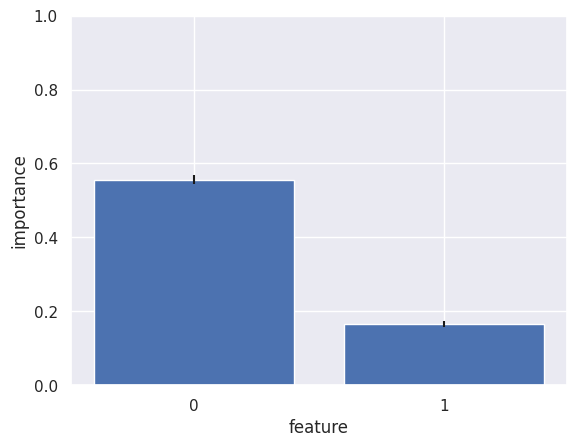

In [61]:
p_importances = permutation_importance(rfc, X, y, n_repeats=10, n_jobs=-1)

plt.bar(['0', '1'],
        p_importances.importances_mean,
        yerr=p_importances.importances_std)
plt.xlabel('feature')
plt.ylabel('importance')
plt.ylim(0, 1);

### EXERCISE 3 : Random forest classifier for FMNIST


In [62]:
fashion_mnist = tf.keras.datasets.fashion_mnist
(train_images, train_labels), (test_images, test_labels) = fashion_mnist.load_data()

n = len(train_labels)
x_train = train_images.reshape((n, -1))
y_train = train_labels

n_test = len(test_labels)
x_test = test_images.reshape((n_test, -1))
y_test = test_labels

Classify fashion MNIST images with Random Forest classifier.

In [63]:
# 1. Create classifier. As the number of features is big (784), use bigger tree
# depth (max_depth parameter), try in range 10-500.

# 2. What is the maximum number of leaves in tree of depth n?
# To reduce variance we should avoid leaves with too litle samples. You could
# limit the total number of tree leaves (max_leaf_nodes parameter) to 10-1000.
# Alternatively you can use min_samples_split & min_samples_leaf

# 3. Try different number of estimators (n_estimators)

# 4. Fit the model

# 5. Inspect training and test accuracy

### EXERCISE 4: Random forest regression


In [64]:
X, y, (df_x, df_y) = house_prices_dataset(return_df_xy=True)
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

Predict the house prices.

In [65]:
# 1. Create regressor. (ensemble.RandomForestRegressor)
# Try different number of estimators (n_estimators)

# 2. Fit the model

# 3. Inspect training and test accuracy

# 4. Try to improve performance by adjusting hyperparameters. 
# How does it compare to linear model?

# 5. Use dtreeviz to visualize a tree from the ensamble

# 6. Study the feature importance


# 2. Clustering

Unsupervised learning technique different from supervised ones from the fact that data are not labelled.

We do not aim at fitting a mapping from $X$ to $y$, but to understand pattern in the data cloud $X$.

### 1. K-Means

#### Theory overview.

**Objective:** 

Clustering techniques divide the set of data into group of atoms having common features. Each data point $p$ gets assigned a label $l_p \in \{1,..,K\}$. In this presentation the data points are supposed to have $D$ features, i.e. each data point belongs to $\mathbf{R}^D$.

**Terminology and output of a K-means computation:**
- *Within-cluster variation* : $L_k$ is called within cluster variation. 

- *Silhouette score*: K-means clustering fixes the number of clusters a priori. Some technique must be chosen to score the different optimal clusterings for different $k$. One technique chooses the best *Silouhette score*. Intuitively, this evaluates the typical distance of points within a same clusters and compares it against the typical distance of points belonging to neighboring but different clusters ( https://en.wikipedia.org/wiki/Silhouette_(clustering) ).

#### Sklearn: implementation and usage of K-means.

We start with a 2D example that can be visualized.

First we load the data-set.

In [66]:
points=km_load_th1()

Explore the data-set checking the dataset dimensionality.

In [67]:
sh = points.shape
print(sh)
n_p, n_f = sh
print(f'We have {n_p} points with {n_f} features')

(120, 2)
We have 120 points with 2 features


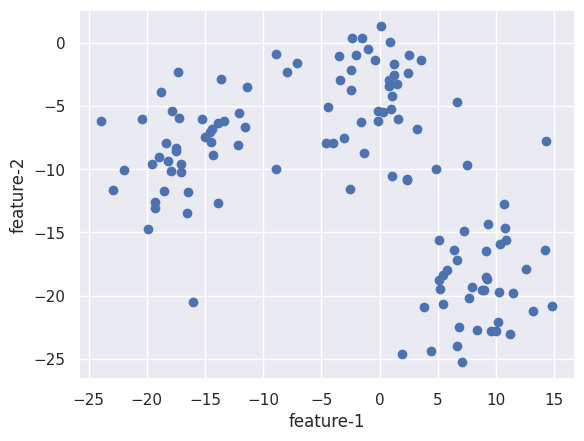

In [68]:
plt.plot(points[:,0], points[:,1], 'o')
plt.xlabel('feature-1')
plt.ylabel('feature-2')
plt.show()

It looks visually that the data set has three clusters. We will cluster them using K-means. As usual, we create a KMeans object. Note that we do not need to initialize it with a data-set.

In [69]:
clusterer = KMeans(n_clusters=3, random_state=10)

A call to the fit method computes the cluster centers which can be plotted alongside the data-set. They are accessible from the cluster_centers_ attribute:

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


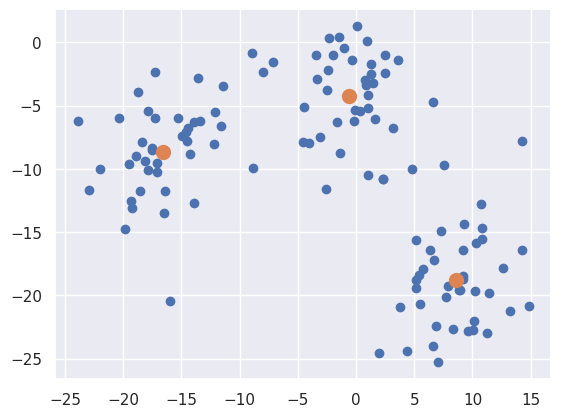

In [70]:
clusterer.fit(points)

plt.plot(points[:,0], points[:,1],'o')

plt.plot(clusterer.cluster_centers_[:,0],clusterer.cluster_centers_[:,1],'o',markersize=10)
plt.show()

In [71]:
clusterer.cluster_centers_

array([[-16.59659661,  -8.6652939 ],
       [  8.5901409 , -18.82448838],
       [ -0.62089021,  -4.27748903]])

The predict method assigns a new point to the nearest cluster. We can use predict with the training dataset and color the data-set according to the cluster label.

In [72]:
cluster_labels=clusterer.predict(points)
print(cluster_labels.shape)

(120,)


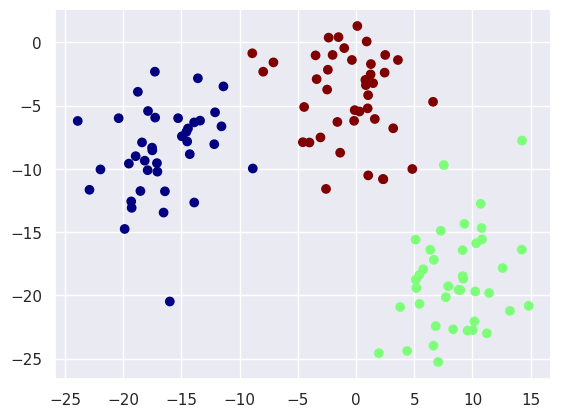

In [73]:
plt.scatter(points[:,0], points[:,1], c=cluster_labels, cmap='jet')
plt.show()

Finally, we can try to vary the number of clusters and score them with the Silhouette score.

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


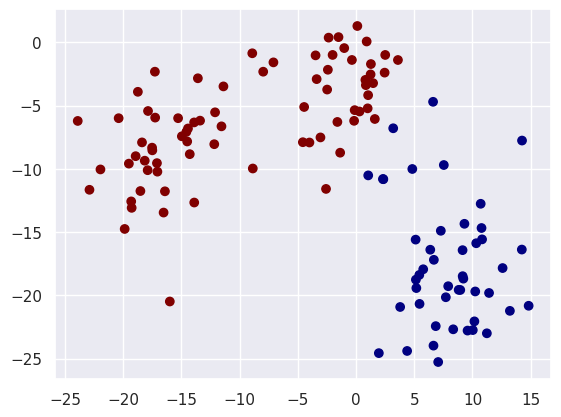

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


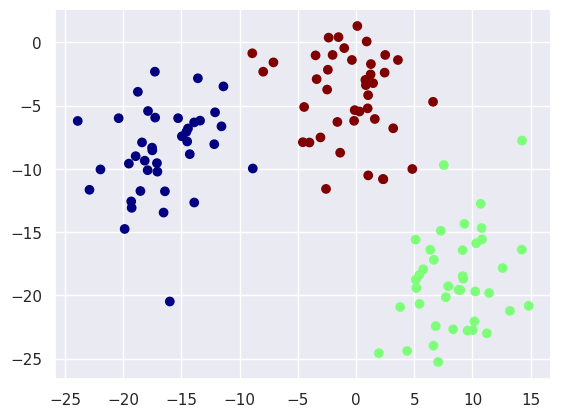

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


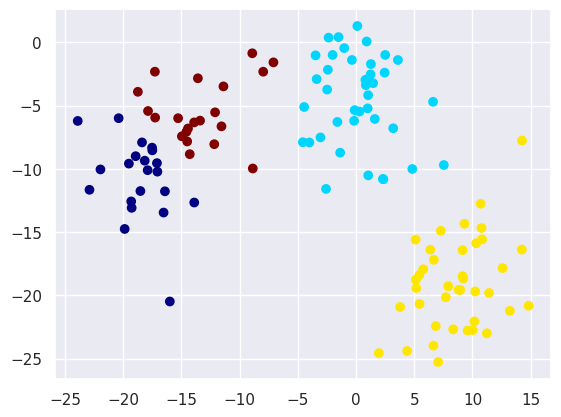

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


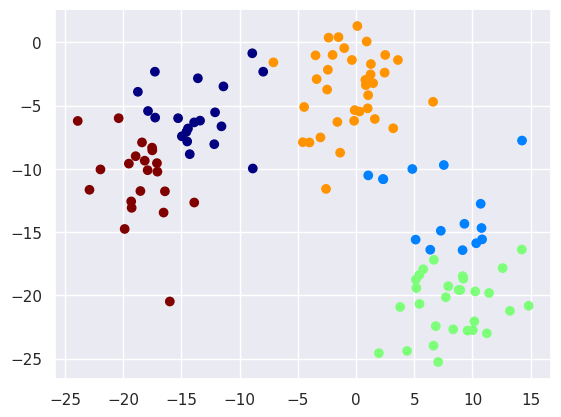

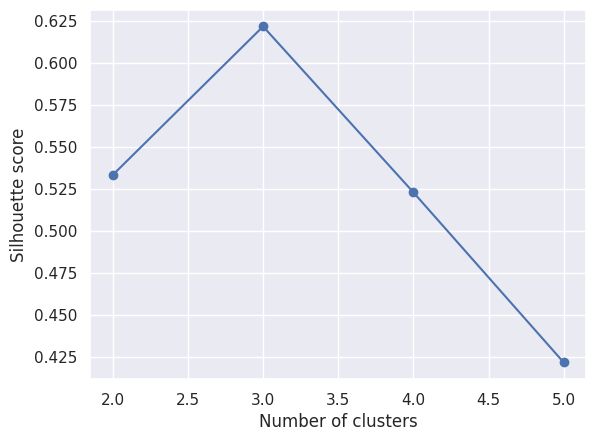

In [74]:
sil=[]

for iclust in range(2,6):
    clusterer = KMeans(n_clusters=iclust, random_state=10)
    cluster_labels = clusterer.fit_predict(points)
    score=silhouette_score(points,cluster_labels)
    sil.append(score)
    plt.scatter(points[:,0],points[:,1],c=cluster_labels, cmap='jet')
    plt.show()
    
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette score')
plt.plot(np.arange(len(sil))+2, sil,'-o')
plt.show()

The same techniques can be used on high dimensional data-sets. We use here the famous MNIST dataset for integer digits, that we are downloading from tensorflow.

In [75]:
fmnist = tf.keras.datasets.fashion_mnist
(train_images, train_labels), (test_images, test_labels) = fmnist.load_data()

X=train_images[:5000,:].reshape(5000,-1)

(5000, 784)


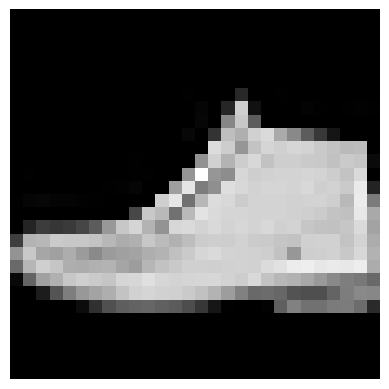

In [76]:
print(X.shape)
image=X[1232,:].reshape(28,28)
plt.imshow(image, cmap='gray')
plt.axis('off')
plt.grid(False)


We can cluster the images exactly as we did for the 2d dataset.

In [77]:
clusterer = KMeans(n_clusters=10, random_state=10)
cluster_labels = clusterer.fit_predict(X)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


We can plot the cluster centers (which are 2D figures!) to see if the clustering is learning correct patterns! 

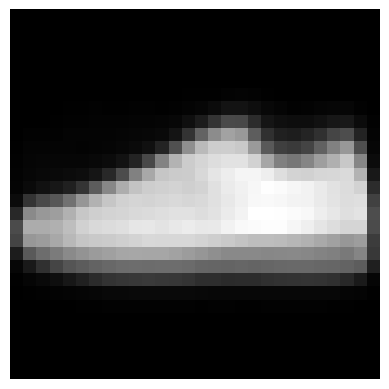

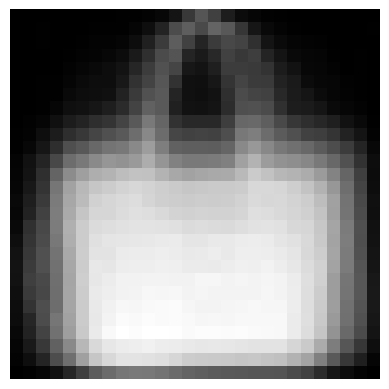

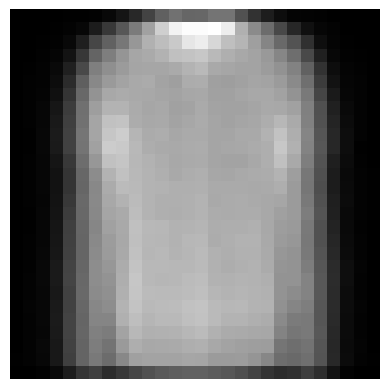

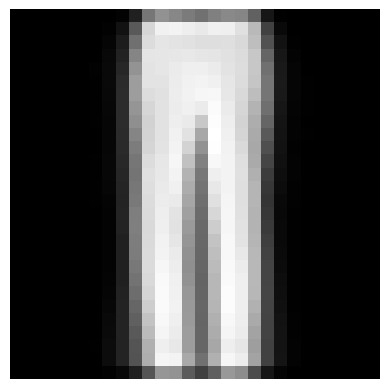

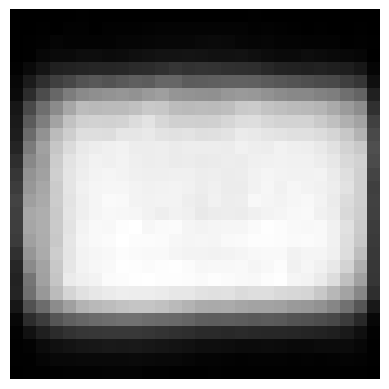

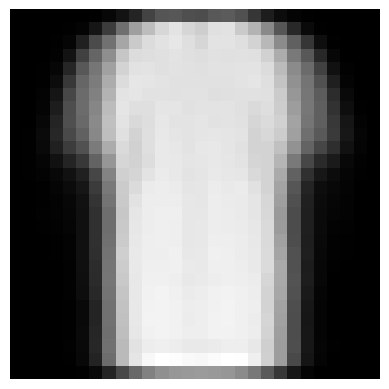

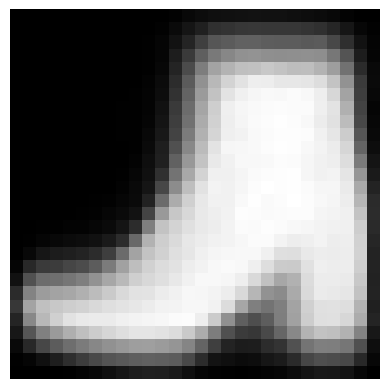

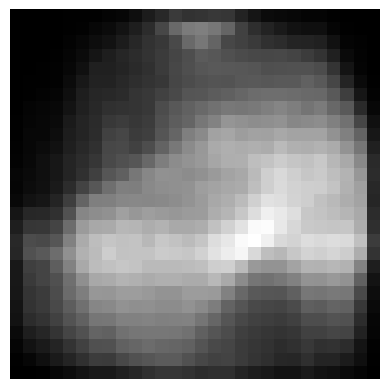

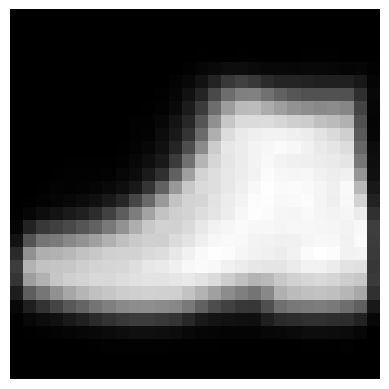

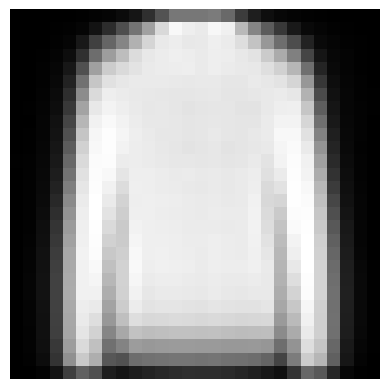

In [78]:
for iclust in range(10):
    plt.imshow(clusterer.cluster_centers_[iclust].reshape(28,28), cmap='gray')
    plt.axis('off')
    plt.grid(False)
    plt.show()

You can see that the model looks to assign one class to the same good. Nevertheless, using the cluster centers and with a further trick, in exercise 2 you will build a digit recognition model !

#### EXERCISE 1: Discover the number of Gaussians

In [ ]:
### In this exercise you are given the dataset points, consisting of high-dimensional data. It was built taking random 
# samples from a number k of multimensional gaussians. The data is therefore made of k clusters but, being 
# very high dimensional, you cannot visualize it. Your task it to use K-means combined with the Silouhette 
# score to find the number of k.

# 1. Load the data using the function points=load_ex1_data_clust() , check the dimensionality of the data.
points= ...
npoints, ndims = ...
print(npoints,ndims)

# 2. Fix the number of clusters k and define a KMeans clusterer object. Perform the fitting and compute the Silhouette score. 
# Save the results on a list. 
res= ...
for n_clusters in ... :
    clusterer = ...
    cluster_labels = ...
    score= ...
    res.append(score)
    
# 3. Plot the Silhouette scores as a function ok k? What is the number of clusters ?
plt.plot(...,...,'-o')

# 4. Optional. Check the result that you found via umap. Remember the syntax umap_model=umap.UMAP(random_state=xxx) to 
# istantiate the umap model and than use fit_transform to compute the coordinate with the reduced dimensionality. 

#### EXERCISE 2: Predict the garment using K-Means

###### DESCRIPTION ###############

In this exercise you are asked to use the clustering performed by K-means to predict the good in the F-mnist dataset. We show here how clustering can be used as a preprocessing tool for a supervised task !

We will follow the pipeline to fit the model :

1- We perform K-means clustering using just the input data and fixing for the start the number of clusters to 10 ;

2- To each cluster, we will attach a label, finding the most represented good inside that cluster. Let's call that label
 assignment[c] for cluster c ;  
 
When using the model for prediction of a new image we will :

1- Find the cluster center nearest to the new image ;

2- Assign the new image to the good most represented in that cluster

In [ ]:
# Follow the following STEPS to solve the exercise

# STEP 1. Load the dataset and reshape it accordingly.
fmnist = ...
(train_images, train_labels), (test_images, test_labels) = ...
X_train=train_images[:5000,:].reshape(...,...)
y_train=train_labels[:5000]
X_test=test_images[:1000,:].reshape(...,...)
y_test=test_labels[:1000]


# STEP 2. 
# Define the cluster KMeans object and fit the model on the training set. 
clusterer = ...
clusterer.fit(...)

# STEP 3. 
# Compute the cluster labels. 
cluster_labels=...

# STEP 4. 
# Compute the assignment list. assignment[i] will be the majority class of the i-cluster  
# You can use, if you want,  the function most_common with arguments (k,y_train, cluster_labels) 
# this compute the assignment list. Print the assignment list to explore its values.

def most_common(nclusters, supervised_labels, cluster_labels):
    """
    Args:
    - nclusters : the number of clusters
    - supervised_labels : for each garment, the labelling provided by the training data ( e.g. in y_train or y_test)
    - cluster_labels : for each garment, the cluster it was assigned by K-Means using the predict method of the Kmeans object
    
    Returns:
    - a list "assignment" of lengths nclusters, where assignment[i] is the majority class of the i-cluster 
    """
    assignment=[]
    for icluster in range(nclusters):
        indices=list(supervised_labels[cluster_labels==icluster])
        try:
            chosen= max(set(indices), key=indices.count)
        except ValueError :
            print('Em')
            chosen=1
        assignment.append(chosen)
    return assignment
assignment=...

# STEP 5. 
# Predict the cluster labels for the test set 
cluster_labels_test=...

# STEP 6.
# using the cluster labels predicted in STEP 5 and the previously computed assignment[] list, 
# predict what are according to your model the predicted goods for the test set, call them new_labels
# (The Python notation suggested is called list_comprehension)
new_labels = [assignment[...] for ... in ... ]

# STEP 7.
# Using  a call cm=metrics.confusion_matrix( y_test, new_labels ) you can print the confusion matrix on the test set, 
# which
# provides information on the quality of the fit. Print the percentage of correctly classified examples. 
# For example, you can divide the sum of the elements on the diagonal of cm (save it in denominator "den") 
# and divide by the sum of all entries of cm (save it in numerator "num").  
cm= ...
print(cm)
num=...
den=...
accuracy=num/den
print(num/den)

#  Perform again steps 2 / 7 increasing the number of clusters from 10 to 40 what happens to the performance ? 
for iclust in ... :
    print(f'Test set with {iclust} clusters')
    # BEGIN OF YOUR CODE . 
    # ...
    # END OF YOUR CODE
    print(assignment)
    print(accuracy)
    print(cm)
    return traj

### 2. Hierarchical clustering

**Objective:** 

In hierarchical clustering we do not have only an optimal set of clusters, but for each different "length scale" we have a different set of clusters.

**Algorithm:** 

- We start with a length scale $l=0$ at the beginning and consider all sample elements as different clusters.

- We increase than $l$ to values larger than zero. Let's call the minimum distance between pair of points $l_0$. As soon as we reach $l=l_0$, these elements are merged into a new cluster (greedy strategy). 

To proceed further we need to define a distance between subsets $S_1,S_2$ of points. In the "single linkage" flavour we define:

$$d(S_1,S_2)=min_{a\in S_1, b\in S_2} d(a,b)$$

- This way we can proceed increasing $l>l_0$. As soon as we find two clusters with distance smaller than $l_1>l_0$, we merge them. 

- We keep on increasing $l$ as far as one one cluster remains

The result of this clustering procedure can be summarized in a `dendrogram`

237


interactive(children=(FloatSlider(value=3.0, description='t', max=7.0), Output()), _dom_classes=('widget-inter…

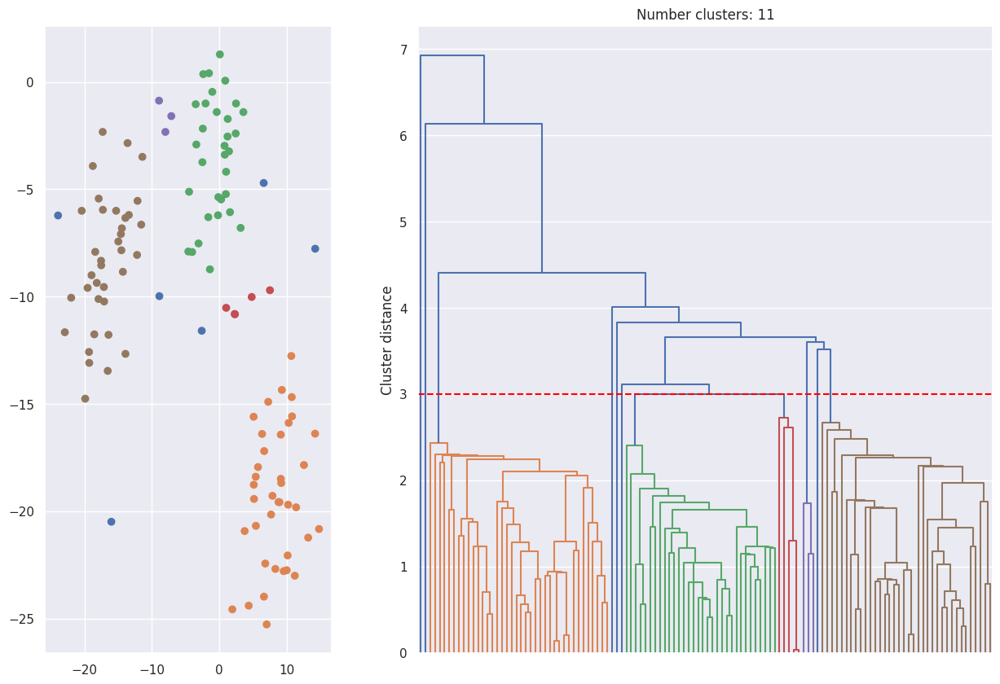

In [332]:
from scipy.cluster.hierarchy import linkage, dendrogram
from scipy.cluster import hierarchy
from ipywidgets import interact
from scipy.cluster.hierarchy import fcluster

points=km_load_th1()
Z = hierarchy.linkage(points, 'single')
n_clusters=int(np.max(Z[:,[0,1]].flatten()))
print(n_clusters)

@interact
def plot(t=(0,7,0.1)):  
    fig, axes=plt.subplots(1,2,figsize=(15,10), gridspec_kw={'width_ratios': [1, 2]})
    fl = fcluster(Z,t=t,criterion='distance')
    maps={}
    for clust in range(n_clusters):
        maps[clust]=(fl==clust)
    c=0
    for clust in range(n_clusters):
        if np.sum(maps[clust])>0:
            c+=1
    d = hierarchy.dendrogram(Z,ax=axes[1], color_threshold=t)
    axes[1].axhline(t,linestyle='--',color='red')
    axes[1].set_ylabel('Cluster distance')
    axes[1].axes.get_xaxis().set_visible(False)
    axes[1].set_xlabel('Points')
    axes[1].set_title(f'Number clusters: {c}')
    axes[0].scatter(points[d['leaves'],0],points[d['leaves'],1], color=d['leaves_color_list'])


**Properties:** 

If we fix a certain cutoff length $l_c$, the clusters identified $C_1,...,C_n$ at that length are such that : 

1- The constintute a disjoint partition of the whole dataset, i.e. they are mutually non intersecting aand each point belongs to a cluster 

2- The distance between two clusters $d(C_1,C_j)$ is larger than $l_c$ for each $i,j$. 

( Check of point 2: If it was smaller, take $A,B$ such that $d(A,B)=d(C_1,C_j)=l'<l_c$ and $A \in C_1$, $B \in C_2$. But than, when merging clusters at length scale $l'$ the clusters at which $A,B$ belonged to, would have been merged. By construction, after two points are merged into the same cluster at a length scale, they belong to the same cluster at all larger length scales. This is a contradiction. )

### 3. Gaussian mixtures

#### Theory overview.

K-Means is a modelling procedure which is biased towards clusters of circular shape and therefore does not always work perfectly, as the following examples show:

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


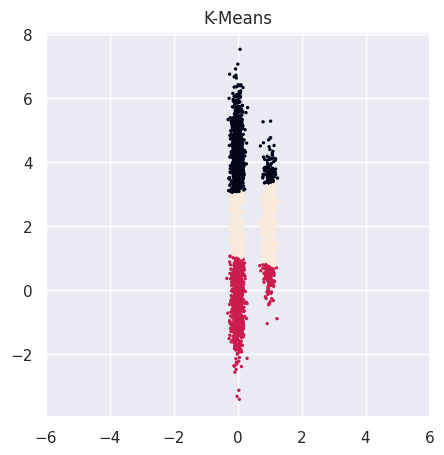

In [333]:
points=gm_load_th1()
clusterer = KMeans(n_clusters=3, random_state=10, )
cluster_labels=clusterer.fit_predict(points)
plt.figure(figsize=(5,5))
plt.gca().set_aspect('equal')
plt.title('K-Means')
plt.xlim(-6,6)
plt.scatter(points[:,0],points[:,1],c=cluster_labels, s=2)
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


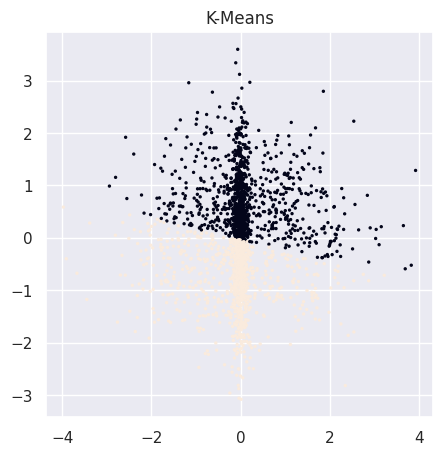

In [334]:
points=gm_load_th2()
clusterer = KMeans(n_clusters=2, random_state=10)
cluster_labels=clusterer.fit_predict(points)
plt.figure(figsize=(5,5))
plt.title('K-Means')
plt.scatter(points[:,0],points[:,1],c=cluster_labels, s=2)

A Gaussian mixture model is able to fit these kinds of clusters. In a Gaussian mixture model, each data-set is supposed to be a random point from the distribution:
$$f(\mathbf{x})=\sum_c \pi_c N(\mathbf{\mu_c},\mathbf{\Sigma_c} )(\mathbf{x})$$
, which is called a Gaussian mixture (N stands for Normal distribution). The parameters $\{\pi_c,\mathbf{\mu_c},\mathbf{\Sigma_c}\}$ are fitted from the data using a minimization procedure (maximum likelihood via the EM algorithm) and $N_c$ is the chosen number of clusters.

This density has the following interpretation. Suppose each data point $\hat{X}$ is a random variable resulting from the following 2-step procedure:

1- First a random variable $\hat {C}$ is extracted, with values in $\{1,...,N_c\}$ and probabilities $\{\pi_1,...\pi_{N_c}\}$. This random variable fixes a cluster.

2- When we know $\hat {C}=c$ we extract $\hat{X}$ according to the density $N(\mathbf{\mu_c},\mathbf{\Sigma_c} )(\mathbf{x})$.

This procedure is summarized by the formulas:

$$p(\hat{C}=c)=\pi_c$$

$$p(\hat{X}=\mathbf{x}|\hat{C}=c)=N(\mathbf{\mu_c},\mathbf{\Sigma_c})(\mathbf{x})$$

**Output of a GM computation:** 
- *Cluster probabilities:* A gaussian mixtures model is an example of soft clustering, where each data point $p$ does not get assigned a unique cluster, but a distribution over clusters $f_p(c), c=1,...,N_c$. 

Given the fitted parameters,  $f_p(c)$ is computed as: $$f_p(c)=\frac{ \pi_c N(\mathbf{\mu_c},\mathbf{\Sigma_c} )(\mathbf{x_p})}{\sum_{c'} \pi_c N(\mathbf{\mu_{c'}},\mathbf{\Sigma_{c'}} )(\mathbf{x_p})}, c=1...N_c$$ 

, where $\mathbf{x_p}$ are the coordinates of point p. 

This formula follows from our probabilistic interpretation and Bayes theorem:

$$f_p(c)=p(\hat{C}=c|\hat{X}=\mathbf{x_p}) \sim p(\hat{X}=\mathbf{x_p}|\hat{C}=c) p(\hat{C}=c)=N(\mathbf{\mu_c},\mathbf{\Sigma_c} )(\mathbf{x_p})\pi_c $$

- *AIC/BIC:* after each clustering two numbers are returned. These can be used to select the optimal number of Gaussians to be used, similar to the Silhouette score. ( AIC and BIC consider both the likelihood of the data given the parameters and the complexity of the model related to the number of Gaussians used ). The lowest AIC or BIC value is an indication of a good fit.

#### Sklearn: implementation and usage of Gaussian mixtures

First of all, we see how the Gaussian model behaves on our original example:

2 1607.6200523512434 1638.282461521846


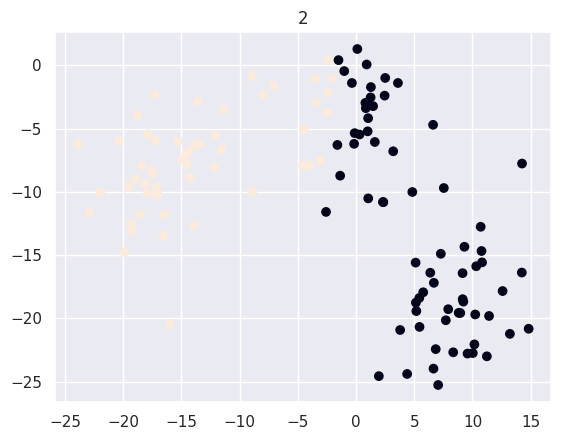

3 1550.4974051432473 1597.884764770542


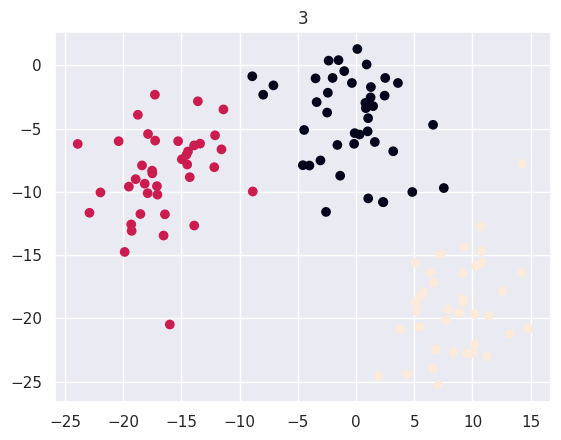

4 1555.3841898343276 1619.4964999183146


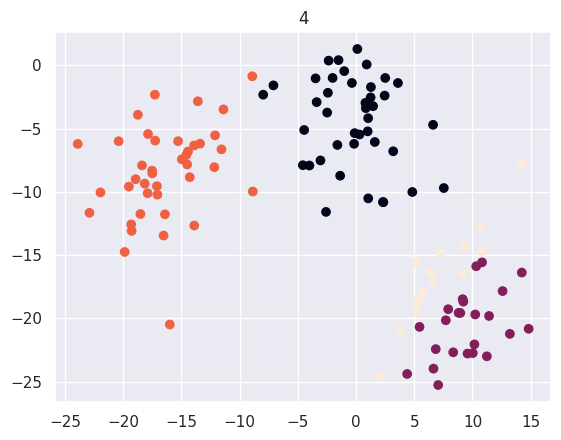

5 1552.1450684409297 1632.982328981609


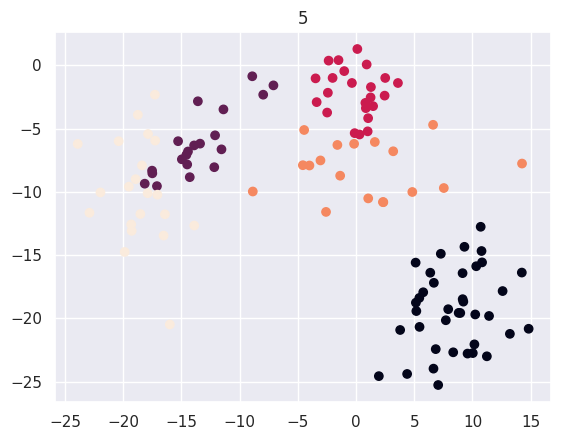

In [335]:
points=km_load_th1()

aic=[]
bic=[]
sil=[]

for i_comp in range(2,6):
    plt.figure()
    plt.title(str(i_comp))
    clf = GaussianMixture(n_components=i_comp, covariance_type='full')
    clf.fit(points)
    cluster_labels=clf.predict(points)
    plt.scatter(points[:,0],points[:,1],c=cluster_labels)
    print(i_comp,clf.aic(points),clf.bic(points))
    score=silhouette_score(points,cluster_labels)
    aic.append(clf.aic(points))
    bic.append(clf.bic(points))
    sil.append(score)
    plt.show()

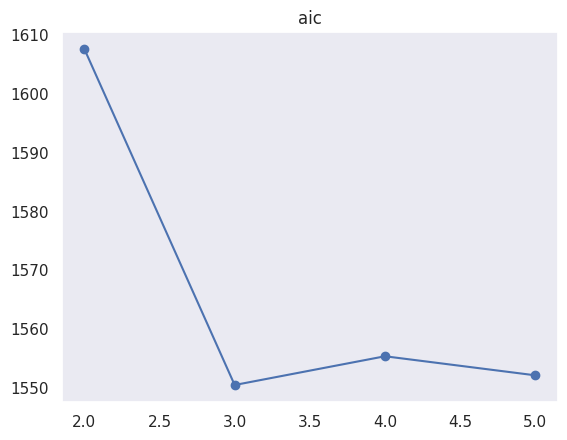

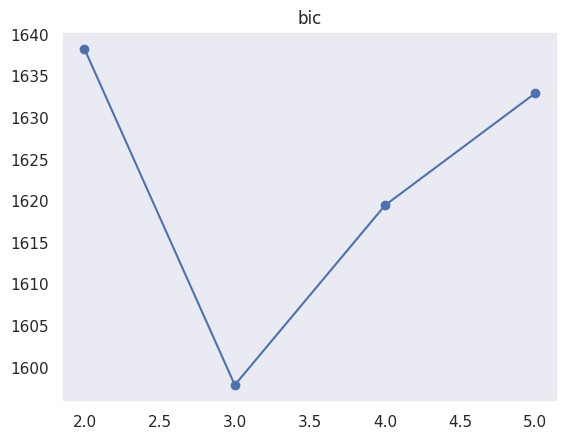

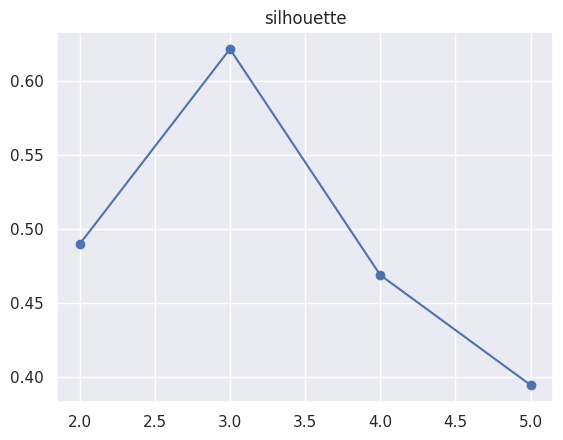

In [336]:
plt.plot(np.arange(2,6),aic,'-o')
plt.title('aic')
plt.grid()
plt.show()

plt.plot(np.arange(2,6),bic,'-o')
plt.title('bic')
plt.grid()
plt.show()

plt.plot(np.arange(2,6),sil,'-o')
plt.title('silhouette')
plt.show()

So in this case we get a comparable result, and also the probabilistic tools agree with the Silhouette score ! Let's see how the Gaussian mixtures behave in the examples where K-means was failing.

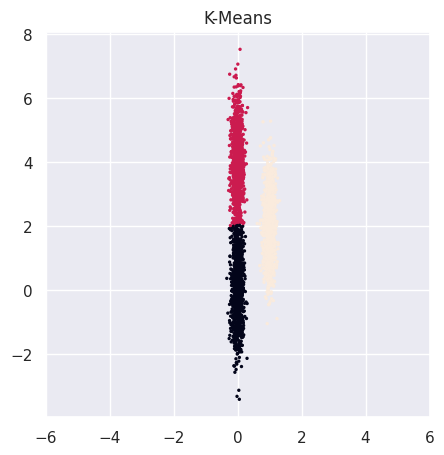

In [351]:
points=gm_load_th1()
clf = GaussianMixture(n_components=3, covariance_type='full')
clf.fit(points)
cluster_labels=clf.predict(points)
plt.figure(figsize=(5,5))
plt.gca().set_aspect('equal')
plt.title('K-Means')
plt.xlim(-6,6)
plt.scatter(points[:,0],points[:,1],c=cluster_labels, s=2)
plt.show()

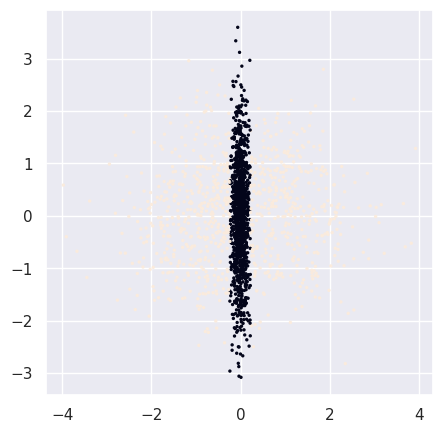

In [356]:
points=gm_load_th2()
clf = GaussianMixture(n_components=2, covariance_type='full')
clf.fit(points)
cluster_labels=clf.predict(points)
plt.figure(figsize=(5,5))
plt.scatter(points[:,0],points[:,1],c=cluster_labels, s=2)
plt.show()

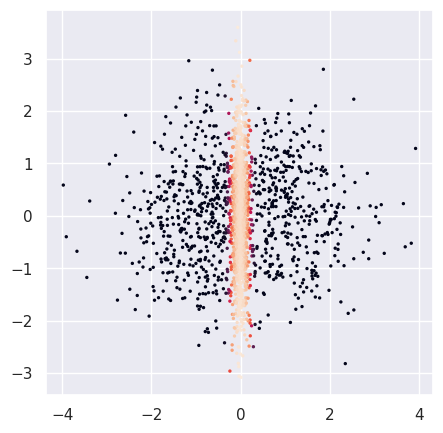

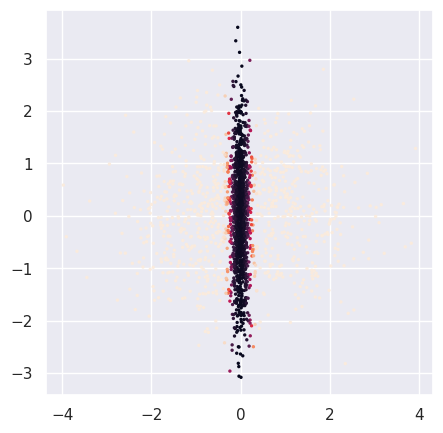

<ipython-input-358-69b3adc18d08>:10: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


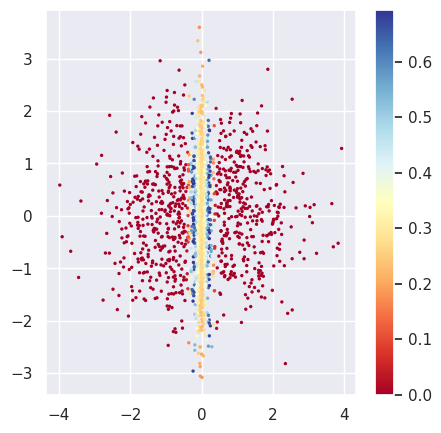

In [358]:
cluster_p=clf.predict_proba(points)
e = entropy(cluster_p, axis=1)
plt.figure(figsize=(5,5))
plt.scatter(points[:,0],points[:,1],c=cluster_p[:, 0], s=2)
plt.show()
plt.figure(figsize=(5,5))
plt.scatter(points[:,0],points[:,1],c=cluster_p[:, 1], s=2)
plt.show()
plt.figure(figsize=(5,5))
cm = plt.cm.get_cmap('RdYlBu')
sc = plt.scatter(points[:,0],points[:,1],c=e, s=2, cmap=cm)
plt.colorbar(sc)
plt.show()

#### EXERCISE 4: Find the prediction uncertainty

In [ ]:
#In this exercise you need to load the dataset used to present K-means ( def km_load_th1() ) or the one used to discuss 
# the Gaussian mixtures model ( def gm_load_th1() ). 
#As discussed, applying a fitting based on gaussian mixtures you can not only predict the cluster label for each point, 
#but also a probability distribution over the clusters. 

#From this probability distribution, you can compute for each point the entropy of the corresponging 
#distribution (using for example scipy.stats.entropy) as an estimation of the undertainty of the prediction. 
#Your task is to plot the data-cloud with a color proportional to the uncertainty of the cluster assignement.

# In detail you shoud:
# 1. Instantiate a GaussianMixture object with the number of clusters that you expect
# 2. fit the object on the dataset with the fit method 

points=gm_load_th1()

plt.figure()
clf = GaussianMixture(..., covariance_type='full')
clf...(...)

# 3. compute the cluster probabilities using the method predict_proba. This will return a matrix of 
# dimension npoints x nclusters (check that this is the case!)
# 4. use the entropy function ( from scipy.stats you need to import the entropy 
# function ) to evaluate for each point the uncertainty of the 
#prediction. Check here if in doubt: https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.entropy.html

cluster_labels_prob=...

from ... import ...
entropies=[]
for point in range(len(...)):
    entropies.append(...)

# 5. Plot the points colored accordingly to their uncertanty. 

cm = plt.cm.get_cmap('RdYlBu')
sc = plt.scatter(points[:,0], points[:,1], c=entropies, cmap=cm)
plt.colorbar(sc)
    

### 4. Final comments

We covered here the most basic clustering techniques, showcasing different behaviors. For real like projects, there are also other algorithms that could be taken into consideration, e.g.:

- DBSCAN : https://en.wikipedia.org/wiki/DBSCAN
- Spectral Clustering : https://towardsdatascience.com/spectral-clustering-aba2640c0d5b

Both these methods can fit also clusters with weirder shapes.

<img src="https://github.com/neworldemancer/DSF5/raw/master/figures/clusters.png" width="100%"/>

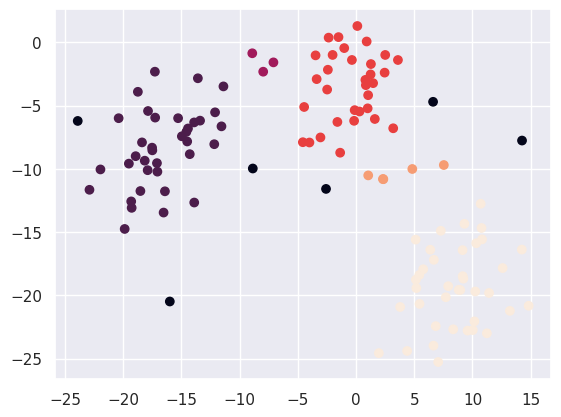

n_cluster=5, score=0.39040394902465214


In [ ]:
clustering = DBSCAN(eps=3, min_samples=2)
cluster_labels = clusterer.fit_predict(points)
score=silhouette_score(points,cluster_labels)
plt.scatter(points[:,0],points[:,1],c=cluster_labels)
plt.show()
print(f'n_cluster={max(cluster_labels)+1}, score={score}')

# 3. Dimensionality Reduction

### 1. Principal Component Analysis (PCA)

Let's start with the example that we will use to make the theory more concrete. We will take a dataset from from kaggle https://www.kaggle.com/datasets/miroslavsabo/young-people-survey?resource=download (already downloaded for you in the folder `data`)

The datasets consists of the results of a survey about the music preferences of several students, arriving at the following dataset:

In [83]:
data=pd.read_csv("data/responses.csv")

In [84]:
data

,Music,Slow songs or fast songs,Dance,Folk,Country,Classical music,Musical,Pop,Rock,Metal or Hardrock,...,Age,Height,Weight,Number of siblings,Gender,Left - right handed,Education,Only child,Village - town,House - block of flats
0,5.0,3.0,2.0,1.0,2.0,2.0,1.0,5.0,5.0,1.0,...,20.0,163.0,48.0,1.0,female,right handed,college/bachelor degree,no,village,block of flats
1,4.0,4.0,2.0,1.0,1.0,1.0,2.0,3.0,5.0,4.0,...,19.0,163.0,58.0,2.0,female,right handed,college/bachelor degree,no,city,block of flats
2,5.0,5.0,2.0,2.0,3.0,4.0,5.0,3.0,5.0,3.0,...,20.0,176.0,67.0,2.0,female,right handed,secondary school,no,city,block of flats
3,5.0,3.0,2.0,1.0,1.0,1.0,1.0,2.0,2.0,1.0,...,22.0,172.0,59.0,1.0,female,right handed,college/bachelor degree,yes,city,house/bungalow
4,5.0,3.0,4.0,3.0,2.0,4.0,3.0,5.0,3.0,1.0,...,20.0,170.0,59.0,1.0,female,right handed,secondary school,no,village,house/bungalow
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1005,5.0,2.0,5.0,2.0,2.0,5.0,4.0,4.0,4.0,3.0,...,20.0,164.0,57.0,1.0,female,right handed,secondary school,no,city,house/bungalow
1006,4.0,4.0,5.0,1.0,3.0,4.0,1.0,4.0,1.0,1.0,...,27.0,183.0,80.0,5.0,male,left handed,masters degree,no,village,house/bungalow
1007,4.0,3.0,1.0,1.0,2.0,2.0,2.0,3.0,4.0,1.0,...,18.0,173.0,75.0,0.0,female,right handed,secondary school,yes,city,block of flats
1008,5.0,3.0,3.0,3.0,1.0,3.0,1.0,3.0,4.0,1.0,...,25.0,173.0,58.0,1.0,female,right handed,college/bachelor degree,no,city,block of flats


In [89]:
music_columns=data.columns[:19]
print(music_columns)
music_data=data[music_columns].dropna()

Index(['Music', 'Slow songs or fast songs', 'Dance', 'Folk', 'Country',
       'Classical music', 'Musical', 'Pop', 'Rock', 'Metal or Hardrock',
       'Punk', 'Hiphop, Rap', 'Reggae, Ska', 'Swing, Jazz', 'Rock n roll',
       'Alternative', 'Latino', 'Techno, Trance', 'Opera'],
      dtype='object')


The answers are of course correlated and we expect to have typical patterns recurring, that we define as people liking similar types of songs. 

The patterns may be also mixing, for e.g. a class of people may like classic `Pop` and `Reggae`, but not `Latino`. Another class may be `Latino` together with `Reggae`, but not `Pop`.

PCA will help to find these typical patterns and their number in a data driven fashion. As we will see these patterns will naturally appear when trying to compress data in a lower dimensional space.

#### Theory overview.

We will start looking at PCA from the point of view of `dimensionaliy reduction`.

**Objective:** PCA is used for dimensionality reduction when we have a large number $D$ of features with non-trivial intercorrelation ( data redundancy ) and to isolate relevant features. The number of features $D$ defines the original dimension of the dataset. Each sample defines a vector of dimensionality $D$.


PCA provides a new set of $M$ uncorrelated features for every data point, with $M \le D$. The new features are:

- a linear combination of the original ones ; 
- uncorrelated between each other ; 

If $M \ll D$ we get an effective dimensionality reduction.

    QUESTION: Does the number of data points changes after applying PCA?

PCA describes subspaces (lines,planes, and their high dimensional generalizations) as "generated" by a sequence of vectors $v_1,...,v_k$. This is defined as the set of all the vectors:

$$V_{\{v_1,...,v_k\}}=\{ \alpha_1 v_1+...+\alpha_k v_k, \alpha_1,..., \alpha_k \in \mathbf{R} \}$$

PCA will therefore provide a sequence of vectors. Since many choices of $\{v_1,...,v_k\}$ could describe the same "line", "plane", etc. etc., it imposes an orthonormality condition.


**Terminology and output of a PCA computation:** 
- `Principal components`: A sequence of orthonormal vectors $k_1,..,k_n$. We can interpret these vectors as the typical patterns found in the data, from increasing to decreasing probability of appearance. Any vector can be constructed as a linear combination of such patterns. Using only the first $m$ vectors we get a "best approximation".

    
- `Scores`: For every sample-point $p$, the new features are called scores are given by the component of $p$ along the $k$ vectors;  


- `Reconstructed vector`: For every $k$, the projection of $V$ on $V_k$. This is the best approximation that we can get of the vector using only $k$ vectors (principal components).


- `Explained variance`: For every k, the ratio between the variance of the reconstructed vectors and total variance. The number of components is chosen selecting an optimal k. The plot of the explained variance as a function of k is called a *scree plot*

#### Sklearn: implementation and usage of PCA.


https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html#sklearn.decomposition.PCA

We start showing a two-dimensional example that can be easy visualized.

We load the datasets that we are going to use for the examples:

We have  30 samples of dimension  2


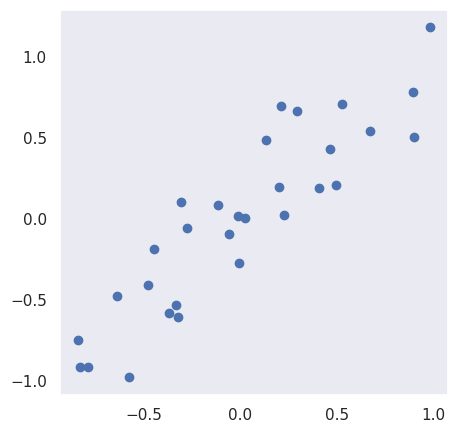

In [90]:
data=load_sample_data_pca()

n_samples,n_dim=data.shape

print('We have ',n_samples, 'samples of dimension ', n_dim)

plt.figure(figsize=((5,5)))
plt.grid()
plt.plot(data[:,0],data[:,1],'o')
plt.show()

The data set is almost one dimensional. PCA will confirm this result.

As with most of sklearn functionalities, we need first to create a PCA object. We will use the object methods to perform PCA.

In [91]:
pca=PCA(n_components=2) 

A call to the pca.fit method computes the principal components

In [92]:
pca.fit(data)

PCA(n_components=2)

Now the pca.components_ attribute contains the principal components. We can print them alongside with the data and check that they constitute an orthonormal basis.

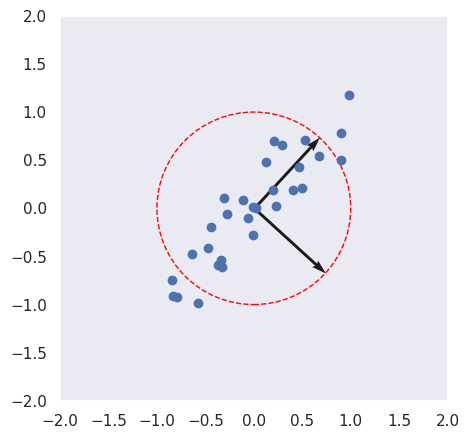

In [93]:
plt.figure(figsize=((5,5)))
plt.grid()
plt.plot(data[:,0],data[:,1],'o')

circle=plt.Circle((0, 0), 1.0, linestyle='--', color='red',fill=False)
ax=plt.gca()
ax.add_artist(circle)

for vec in pca.components_:
    plt.quiver([0], [0], [vec[0]], [vec[1]], angles='xy', scale_units='xy', scale=1)

plt.xlim(-2,2)
plt.ylim(-2,2)
plt.show()

The pca.explained_variance_ratio_ attribute contains the explained variance. In this case we see that already the first reconstructed vector explains 95% of the variance.

In [94]:
print(pca.explained_variance_ratio_)

[0.95140729 0.04859271]


To compute the reconstructed vectors for k=1 we first need to compute the scores and then multiply by the basis vectors:

$\mathbf x_{rec}=\sum_i (\mathbf x \cdot \mathbf v^{pr}_i) \mathbf v^{pr}_i$

In [96]:
k=1
scores=pca.transform(data)
res=np.dot(scores[:,:k], pca.components_[:k,:] )

<ipython-input-97-4510cbd108c3>:6: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "-" (-> linestyle='-'). The keyword argument will take precedence.


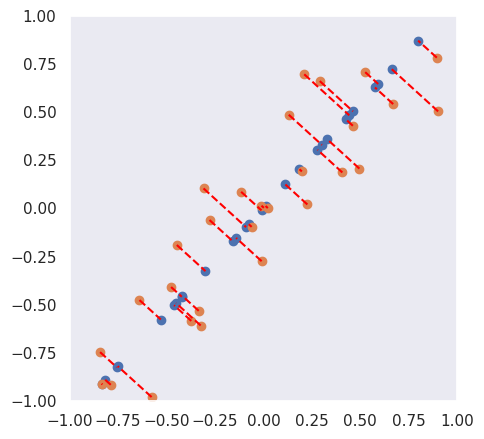

In [97]:
plt.figure(figsize=((5,5)))
plt.plot(res[:,0],res[:,1],'o')
plt.plot(data[:,0],data[:,1],'o')

for a,b,c,d in zip(data[:,0],data[:,1],res[:,0],res[:,1]) :
    plt.plot([a,c],[b,d],'-', linestyle = '--', color='red')

plt.grid()

plt.xlim(-1.0,1.0)
plt.ylim(-1.0,1.0)
plt.show()

The same procedure is followed for high dimensional datasets. Here we generate random data which lies almost on a 6-dimensional subspace. The resulting scree plot can be used to find this result in a semi-automatic fashion.

Let's redo the same now with our survey dataset, to review the concepts again and think "high"-dimensionally.

In [98]:
pca=PCA() 
pca.fit(music_data)

PCA()

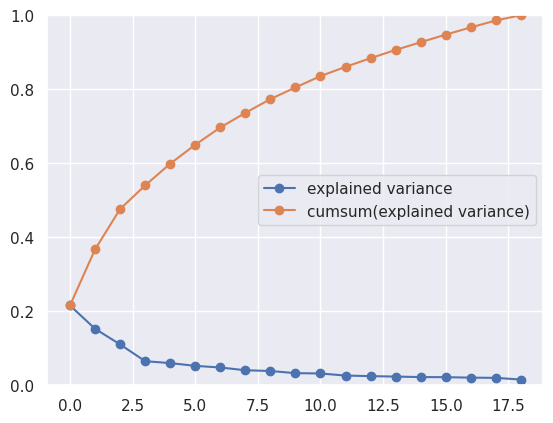

In [103]:
plt.plot(pca.explained_variance_ratio_,'-o', label='explained variance')
plt.plot(np.cumsum(pca.explained_variance_ratio_),'-o', label='cumsum(explained variance)')
plt.legend()
plt.ylim(0, 1);

In [104]:
df = pd.DataFrame(pca.components_.transpose(), 
                  columns = [f'V_{i+1}' for i in range(len(music_columns))], 
                  index=music_columns)
df

,V_1,V_2,V_3,V_4,V_5,V_6,V_7,V_8,V_9,V_10,V_11,V_12,V_13,V_14,V_15,V_16,V_17,V_18,V_19
Music,0.034327,-0.030242,-0.058575,0.003401,-0.005648,0.070442,-0.072589,0.046377,-0.002965,-0.044203,0.005060,-0.112661,0.011120,0.114572,0.140985,-0.138319,-0.223307,0.223824,-0.902855
Slow songs or fast songs,-0.038844,0.001008,-0.150553,0.058194,-0.098439,0.037892,0.008159,-0.023107,-0.106553,0.048223,0.046499,-0.469155,-0.196216,0.302002,0.408006,-0.491768,0.244483,0.258269,0.245515
Dance,-0.108185,-0.351080,-0.242687,0.144840,-0.215340,0.140691,0.072253,0.150583,-0.106101,-0.007872,-0.225787,-0.284248,-0.454947,-0.441326,0.126784,0.223653,-0.171112,-0.224983,-0.016402
Folk,0.198776,-0.190829,0.165786,0.110605,-0.005172,-0.214301,0.350442,0.290317,-0.367466,-0.340010,-0.047813,-0.350712,0.189948,0.291911,-0.329439,0.068718,-0.136498,-0.024515,0.040103
Country,0.170824,-0.140712,0.074469,0.013157,-0.127616,-0.205966,0.493252,0.371091,0.024814,0.188480,0.321041,0.317403,0.049683,-0.341773,0.253690,-0.175941,0.060453,0.217247,-0.013842
Classical music,0.321165,-0.154089,0.246121,0.335864,0.050521,-0.112244,-0.242079,0.058894,0.227351,-0.237305,-0.084052,0.144460,-0.040855,0.015306,0.203028,-0.416664,-0.063652,-0.515503,-0.006618
Musical,0.195235,-0.315976,0.227786,-0.189421,-0.212367,-0.041638,-0.419096,-0.113744,-0.242206,0.473885,0.297234,-0.237463,0.195298,-0.144131,-0.132668,-0.080119,-0.153356,-0.055279,0.037238
Pop,-0.102153,-0.323553,-0.093759,-0.191536,-0.354285,0.196396,-0.257379,0.313967,0.084972,-0.267280,-0.222586,0.120422,0.331245,-0.039526,-0.088276,-0.056829,0.484205,0.097763,-0.038331
Rock,0.307950,0.116657,-0.196066,-0.138037,-0.298001,0.155711,-0.095854,0.090328,0.178293,-0.158085,-0.070379,0.057146,0.217821,0.127137,0.302390,0.159884,-0.586401,0.189754,0.279609
Metal or Hardrock,0.337369,0.277790,-0.224637,0.107211,-0.356716,-0.218770,0.118212,-0.386633,0.140126,-0.183835,0.168455,-0.283392,0.181362,-0.251764,-0.013434,0.139735,0.303840,-0.133485,-0.142317


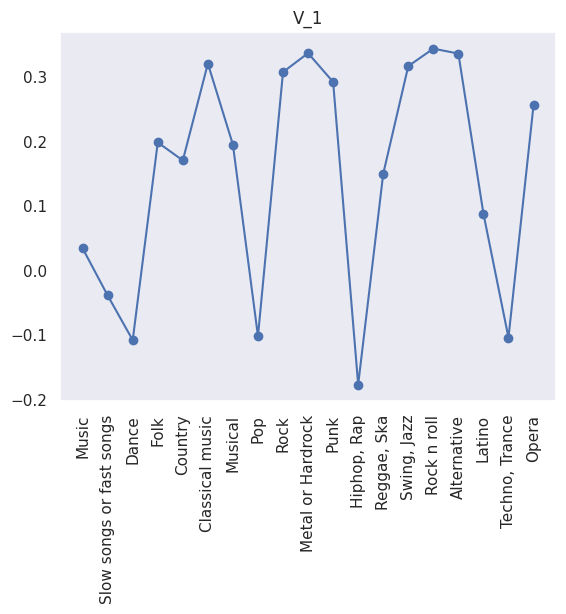

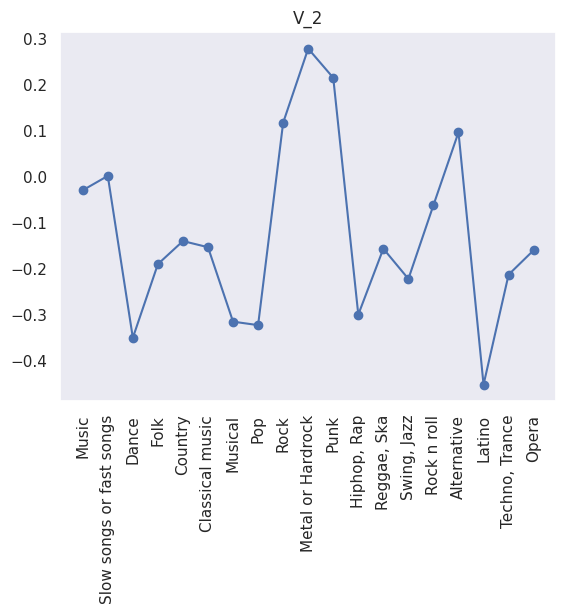

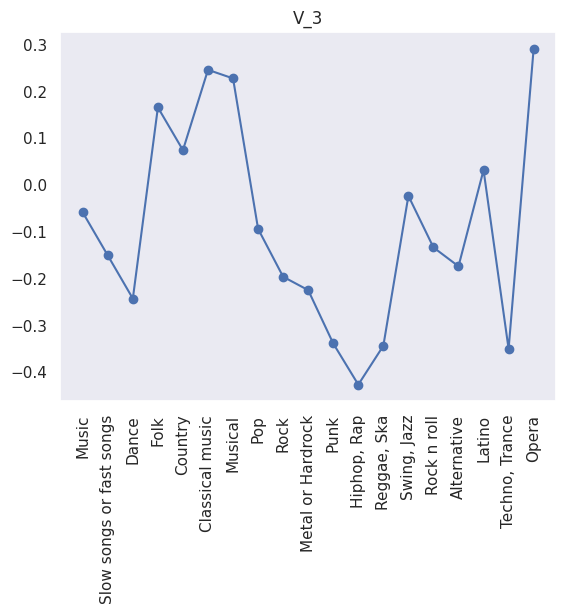

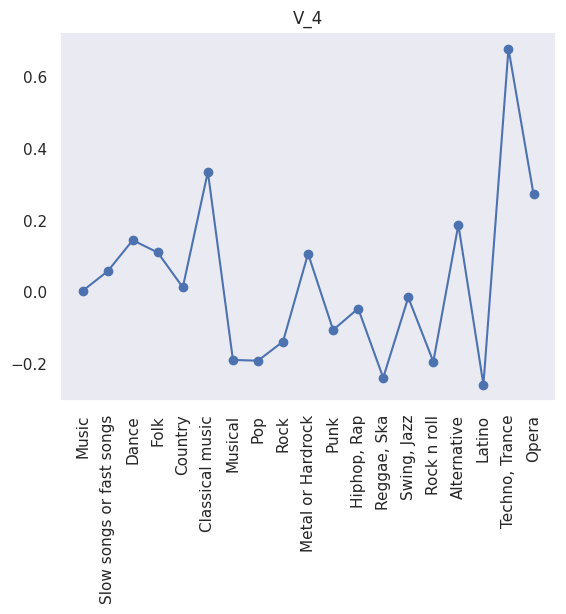

In [105]:
for vector in ['V_1','V_2','V_3','V_4']:
    plt.figure()
    plt.title(vector)
    plt.plot(np.arange(len(music_columns)),list(df[vector]),'-o')
    _=plt.xticks(np.arange(len(music_columns)),music_columns, rotation=90)
    plt.grid()

#### EXERCISE 1 : Find the dimensionality of the hidden dataset.

In [ ]:
# In this exercise you will take a custom high dimensional dataset and try to find its dimensionality 

# 1. Load the data using the function data=load_multidimensional_data_pca2() , check the dimensionality of the data and plot them.
data=...
n_samples,n_dim=... 
print('We have ',n_samples, 'samples of dimension ', n_dim)

# 2. Define a PCA object and perform the PCA fitting.
pca=PCA()
pca....

# 3. Check the explained variance ratio and select best number of components.
print(pca...)
plt.plot(...)


#### EXERCISE 2 : Find the dataset shape.

In [ ]:
k = # 
scores=pca.transform(data)

# visualize the `scores.T[:k]` with a scatterplot


### Final comments:

PCA is able therefore to make this mapping:

$(x_1,...,x_D) \rightarrow (y_1,..,y_M)$

Here we focused on data compression, but it is also very important that $y_1,...,y_M$ are uncorrolated for interpratibility purposes. Being uncorrelated means (roughly) that in our dataset we can change one variable without affecting the others. The dimensions 1,...,M are often therefore more interpretable and providing more information.

See e.g. a similar application here:

"Principal component analysis of dietary and lifestyle patterns in relation to risk of subtypes of esophageal and gastric cancer", https://pubmed.ncbi.nlm.nih.gov/21435900/

, where each data point $x$ is an answer from a questionnaire of food. The principal components are than typical "patterns" of answers that are uncorrlated, have a look at table 2, and if you want read the whole data story :)

### 2. Data visualization and embedding in low dimensions 

#### Theory overview

PCA is a linear embedding technique where the scores are a linear function of the original variables. This forces the number of principal components to be used to be high, if the manifold is highly non-linear. Curved manifolds need to be embedded in higher dimensions.

Other `non-linear` embedding techniques start from a local description of the environment of each sample point in the original space. `UMAP` describes the `topology` of the environment through a generalized "triangulation" (simplex decomposition).

The projection on the low-dimensional space is optimized in order to match as much as possible the description of the local environment. 



The embedding is given by an iterative solution of a minimization problem and therefore the results may depend on the value of the random seed.

#### Example 1: Exercise 3 Cont'd

We will first visualize our multi-dimensional heart using t-SNE: 

In [123]:
data= load_multidimensional_data_pca2()

And using UMAP :

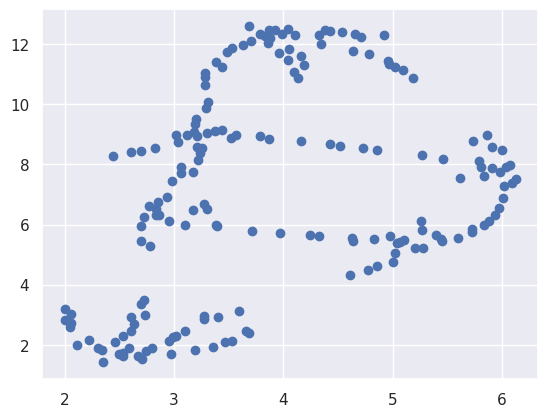

In [131]:
umap_model = umap.UMAP(n_neighbors=50, n_components=2, random_state=1711)

emb = umap_model.fit_transform(data)
plt.scatter(emb[:, 0], emb[:, 1])
plt.show()

#### Example 2: Fashion_Mnist dataset

In [132]:
fmnist = tf.keras.datasets.fashion_mnist
(train_images, train_labels), (test_images, test_labels) = fmnist.load_data()

n_examples = 5000
data=train_images[:n_examples,:].reshape(n_examples,-1)
data=data/255

labels=train_labels[:n_examples]

 | <img src="https://github.com/neworldemancer/DSF5/raw/master/figures/t_sne_fmnist.png" width="100%"/> | <img src="https://github.com/neworldemancer/DSF5/raw/master/figures/fmnist.png" width="100%"/> 
 |  -----:| -----:|

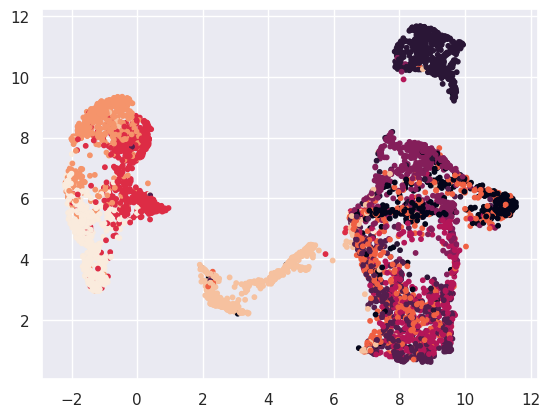

In [133]:
umap_model = umap.UMAP(n_neighbors=50, n_components=2, random_state=1711)
umap_fmnist = umap_model.fit_transform(data)
plt.scatter(umap_fmnist[:, 0], umap_fmnist[:, 1], c=labels, s=10)
plt.show()

#### Example 3: House prices

In [141]:
data, price =house_prices_dataset()
data = StandardScaler().fit_transform(data)

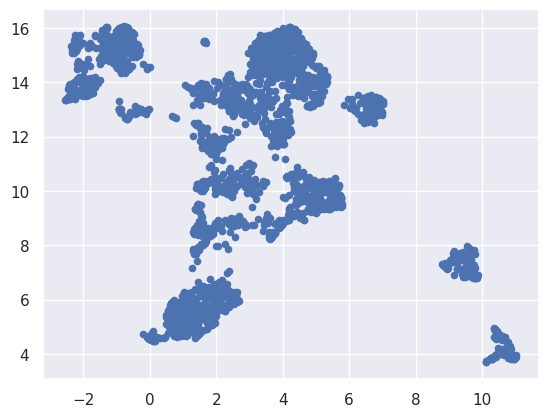

In [142]:
umap_model = umap.UMAP(n_neighbors=30, n_components=2, random_state=1711)
umap_houses = umap_model.fit_transform(data)
plt.scatter(umap_houses[:, 0], umap_houses[:, 1], s=20)
plt.show()

**Message:** Visualization techniques are useful for having an initial grasp of multi-dimensional datasets and guide further analysis and the choice of the modelling data strategy.

**Caveats:** 
- UMAP, thanks to the algorithm being amanable to clever initializations and optimization schemes, offers great stability and scaling properties

- UMAP, even if starting from a local picture, is able to spread apart different clusters

- The result of an embedding may depend on the values of the metaparameters. One should try to see how the final embedding changes in order to get to a complete picture

# 4. Path to success

0. Learn the tools: shortcuts, visualisation, ...

0. Explore the data
1. Data preprocessing: reading data, dealing with outliers/NANs/categorical vars, feature selection


2. From simple models to complex.
3. Independent train/val/test datasets.
7. Optimization: n_jobs=-1
4. Appropriate metrics: `metrics.recall_score()`, `metrics.precision_score()`, `metrics.f1_score()`
5. Interpreting the result
6. Search for best hyperparameters


# ToDo:

- place updated datasets, + reading functions
- go through each. ensure not too confusing
- upload to a different github

# WIP area

In [421]:
pip install auto-sklearn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.5/6.5 MB 36.0 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 68.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 73.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 97.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 260.9/260.9 kB 22.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.2/46.2 kB 4.4 MB/s eta 0:00:00
  Created wheel for auto-sklear

In [423]:
import autosklearn.classification
cls = autosklearn.classification.AutoSklearnClassifier()

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

cls.fit(X_train, y_train)

predictions = cls.predict(X_test)

p, r, F1 = metrics.recall_score(), metrics.precision_score(), metrics.f1_score()
print(f'p, r, F1={p}, {r}, {F1}')

predictions_p = cls.predict_proba(X_test)

y_test_oh = OneHotEncoder(drop='first').fit(y_test)
ap = metrics.average_precision_score(y_test_oh, predictions_p)
print(f'ap={ap}')



ImportError: ignored

## Text

In [1]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.pipeline import Pipeline

In [2]:
# Example text data
documents = [
    "This is the first document.",
    "This document is the second document.",
    "And this is the third one.",
    "Is this the first document?",
]

In [3]:
# Create a pipeline
pipeline = Pipeline([
    ('vect', CountVectorizer()),  # Convert text to token counts
    ('tfidf', TfidfTransformer()),  # Apply TF-IDF transformation
])

In [4]:
pipeline.fit(documents)

Pipeline(steps=[('vect', CountVectorizer()), ('tfidf', TfidfTransformer())])

In [26]:
new_text = ["This is a new document, that is new."]
vectorized_text = pipeline.transform(new_text)

In [27]:
v = pipeline.named_steps['vect']
t = pipeline.named_steps['tfidf']
feature_names = v.get_feature_names_out()
print(feature_names)

['and' 'document' 'first' 'is' 'one' 'second' 'the' 'third' 'this']


In [28]:
v.transform(new_text).todense()

matrix([[0, 1, 0, 2, 0, 0, 0, 0, 1]])

In [29]:
t.get_feature_names_out()

array(['x0', 'x1', 'x2', 'x3', 'x4', 'x5', 'x6', 'x7', 'x8'], dtype=object)

In [30]:
vectorized_text.todense()

matrix([[0.        , 0.4799011 , 0.        , 0.78470118, 0.        ,
         0.        , 0.        , 0.        , 0.39235059]])

## MLP

In [ ]:
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

In [ ]:
X = [[0, 0], [0, 1], [1, 0], [1, 1]]  # Input features
y = [0, 1, 1, 0]  # Target labels

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
# Create a neural network classifier
clf = MLPClassifier(hidden_layer_sizes=(10,), max_iter=1000, random_state=42)

# Train the classifier
clf.fit(X_train, y_train)

In [ ]:
# Predict on the test data
y_pred = clf.predict(X_test)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

# Gen datasets

## smile

In [107]:
im = plt.imread('smile.png').mean(axis=-1)

In [108]:
im.shape

(100, 100)

In [109]:
s = 2
n = 10
yx = np.where(im<0.5)

In [110]:
x = []
y = []

ymax = max(yx[0])
xmax = max(yx[1])
for y0, x0 in zip(*yx):
  xi = np.random.normal(x0-xmax/2, s, size=n)
  yi = np.random.normal(ymax/2-y0, s, size=n)
  x.extend(xi)
  y.extend(yi)
  
x = np.array(x)
y = np.array(y)

idx = np.random.choice(a=len(x), size=len(x)//n, replace=False)
x = x[idx]
y = y[idx]


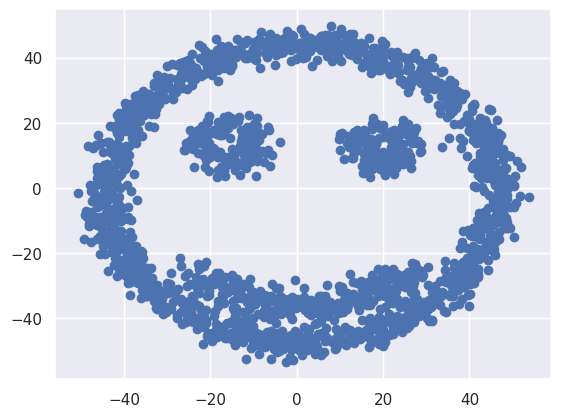

In [111]:
plt.scatter(x, y)

In [112]:
d = {'x':x, 'y':y}
df = pd.DataFrame(d)
df.to_csv('ds_pca_1.csv')

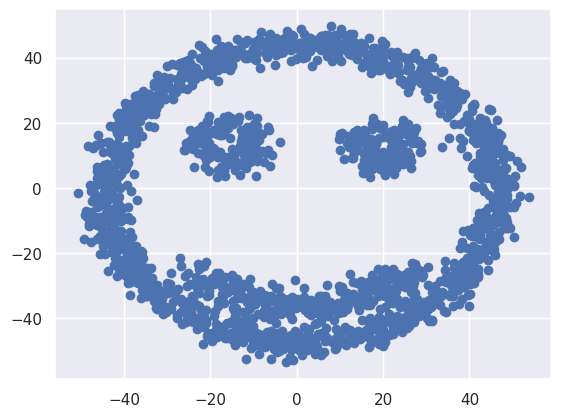

In [113]:
df = pd.read_csv('ds_pca_1.csv')
x = df['x'].to_numpy()
y = df['y'].to_numpy()
plt.scatter(x, y)

In [117]:
d_in = 2
d_out = 12
vectors = np.eye(d_in, d_out)
xy = np.stack([x, y], axis=1)
ds = (xy @ vectors)

rot = get_rand_rot_rev(d_out)
ds = (ds @ rot)

In [118]:
df = pd.DataFrame(ds)

In [119]:
df

,0,1,2,3,4,5,6,7,8,9,10,11
0,-1.413601,-0.242208,2.078746,-2.689527,0.032095,2.937804,-2.843941,5.483274,-15.757356,-2.135825,6.514391,34.459216
1,0.471841,0.079195,-0.688197,0.878599,-0.016474,-0.955141,0.866491,-2.353292,9.873258,2.537009,-5.626439,10.012743
2,-1.899387,-0.324586,2.790172,-3.603855,0.046116,3.934167,-3.778287,7.639183,-23.567874,-3.816903,10.545410,35.130406
3,-2.322960,-0.395763,3.408255,-4.393550,0.060611,4.792897,-4.560360,9.725055,-32.195766,-6.001330,15.420182,27.239429
4,0.963300,0.166454,-1.421370,1.849021,-0.016980,-2.023582,2.008278,-3.292567,6.821317,-0.093023,-1.508807,-41.746236
...,...,...,...,...,...,...,...,...,...,...,...,...
2053,-2.393225,-0.406942,3.508632,-4.517269,0.065208,4.925658,-4.658589,10.270142,-35.382956,-7.057943,17.542667,17.741967
2054,-2.389650,-0.405734,3.501335,-4.503571,0.067204,4.909051,-4.621553,10.444856,-37.006514,-7.710200,18.770781,9.897932
2055,0.247524,0.038647,-0.351085,0.427329,-0.018754,-0.456374,0.309262,-2.152563,13.277269,4.532529,-9.010528,43.015079
2056,-2.051039,-0.347832,3.003795,-3.860674,0.059110,4.207128,-3.946149,9.094583,-32.907241,-7.070177,16.967324,3.158226


In [120]:
df.to_csv('ds_pca_1.csv')

## Elipsoid

In [36]:
pip install datatour

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [200]:
import datatour as dt

In [173]:
zyx = dt.examples.sphere_equators(n_dim=3)
scale_z = 3
scale_y = 2
zyx[:, 0]*=scale_z
zyx[:, 1]*=scale_y


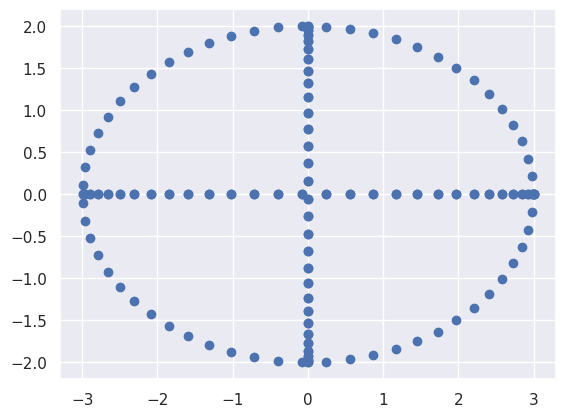

In [174]:
plt.scatter(*(zyx.T[:2]))

In [175]:
import plotly.express as px
z, y, x = zyx.T
fig = px.scatter_3d(x=x, y=y, z=z)
fig.show()

In [106]:
from scipy import sparse


def get_rand_rot(n, i, j, phi=None):
    phi = phi or np.random.uniform(0, np.pi * 2)
    c = np.cos(phi)
    s = np.sin(phi)

    i_arr = [i, i, j, j]
    j_arr = [i, j, i, j]
    v_arr = [c, -s, s, c]
    for diag_idx in range(n):
        if diag_idx != i and diag_idx != j:
            i_arr.append(diag_idx)
            j_arr.append(diag_idx)
            v_arr.append(1)

    rot_mtx = sparse.coo_matrix((v_arr, (i_arr, j_arr)), shape=(n, n))
    return rot_mtx


def get_rand_rot_rev(n):
    rot_matrices = []
    for i in range(n-1):
        for j in range(i+1, n):
            r = get_rand_rot(n, i, j)
            rot_matrices.append(r)

    r_prod = rot_matrices[0]
    for r in rot_matrices[1:]:
        r_prod = r @ r_prod

    return r_prod


In [207]:
d_in = 3
d_out = 6
vectors = np.eye(d_in, d_out)

ds = (zyx @ vectors)

rot = get_rand_rot_rev(d_out)
ds = (ds @ rot)

In [222]:
df = pd.DataFrame(ds)

In [223]:
df

,0,1,2,3,4,5
0,-1.800401,-1.872402,-0.799151,0.009933,-0.888779,-0.907742
1,-1.734554,-1.796436,-0.812441,-0.090576,-0.987333,-1.031774
2,-1.649054,-1.700116,-0.816525,-0.190060,-1.074699,-1.144116
3,-1.544869,-1.584533,-0.811358,-0.287389,-1.149888,-1.243494
4,-1.423180,-1.450996,-0.796998,-0.381463,-1.212049,-1.328783
...,...,...,...,...,...,...
175,0.530072,0.455109,0.142701,-0.743431,-0.810461,-1.330325
176,0.537571,0.504094,0.065346,-0.808175,-0.866710,-1.323772
177,0.538979,0.547366,-0.012749,-0.863761,-0.913139,-1.302219
178,0.534280,0.584437,-0.090700,-0.909561,-0.949222,-1.265912


In [224]:
df.to_csv('ds_pca_2.csv')

In [373]:
df = pd.read_csv('ds_pca_2.csv')

In [374]:
ds = df.to_numpy()[:, 1:]

In [375]:
ds.shape

(180, 6)

In [6]:
ndv = dt.DataTour(ds, n_rot_vectors=10, norm=None)

NameError: ignored

In [245]:
ndv.display()

In [376]:
pca=PCA(n_components=6) 

A call to the pca.fit method computes the principal components

In [405]:
dsn = ds+np.random.normal(loc=0, scale=0.03, size=ds.shape)
pca.fit(dsn)

PCA(n_components=6)

Now the pca.components_ attribute contains the principal components. We can print them alongside with the data and check that they constitute an orthonormal basis.

The pca.explained_variance_ratio_ attribute contains the explained variance. In this case we see that already the first reconstructed vector explains 95% of the variance.

In [406]:
print(pca.explained_variance_ratio_, sum(pca.explained_variance_ratio_))

[6.47391167e-01 2.82248287e-01 6.98478286e-02 2.11648359e-04
 1.52698837e-04 1.48370243e-04] 0.9999999999999998


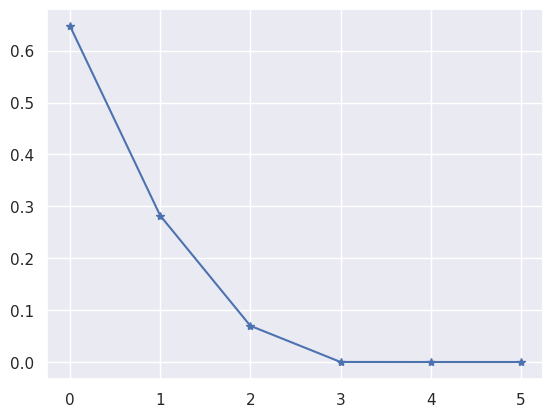

In [407]:
plt.plot(pca.explained_variance_ratio_, '-*')

In [408]:
k=1
scores=pca.transform(dsn)
res=np.dot(scores[:,:k], pca.components_[:k,:] )

In [409]:
scores.shape

(180, 6)

In [410]:
scores.min(axis=0)

array([-3.00477846, -2.03443406, -1.0376613 , -0.08169831, -0.0760983 ,
       -0.05157722])

In [411]:
scores.max(axis=0)

array([3.04682726, 2.09319908, 1.04108366, 0.08903898, 0.07920171,
       0.08074805])

In [418]:
x, y, z = scores.T[:3]
fig = px.scatter_3d(x=x, y=y, z=z, )
fig.show()

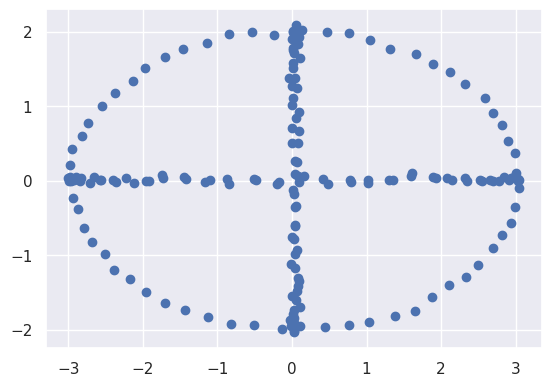

In [416]:
plt.scatter(x, y)
plt.gca().set_aspect('equal')